<a href="https://colab.research.google.com/github/2xente/dashboard/blob/main/implementer_un_model_de_scoring_modelisartion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Code de la modélisation




In [ ]:
#Test de l'activation du GPU
#Si le GPU est activé, il donnera la sortie suivante - '/ device: GPU: 0 '
import tensorflow as tf
tf.test.gpu_device_name ()

'/device:GPU:0'

In [ ]:
#Appareils utilisés lors de l'exécution du notebook dans le cloud
from tensorflow.python.client import device_lib
device_lib.list_local_devices ()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 1647631358659849451
 xla_global_id: -1,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 21985886208
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 12907119282580212155
 physical_device_desc: "device: 0, name: NVIDIA L4, pci bus id: 0000:00:03.0, compute capability: 8.9"
 xla_global_id: 416903419]

In [ ]:
#Vérification de la RAM
!cat /proc/meminfo

MemTotal:       55533064 kB
MemFree:        50196052 kB
MemAvailable:   53069068 kB
Buffers:          142436 kB
Cached:          3218048 kB
SwapCached:            0 kB
Active:           521992 kB
Inactive:        4266656 kB
Active(anon):       1492 kB
Inactive(anon):  1437140 kB
Active(file):     520500 kB
Inactive(file):  2829516 kB
Unevictable:           8 kB
Mlocked:               8 kB
SwapTotal:             0 kB
SwapFree:              0 kB
Dirty:               232 kB
Writeback:             0 kB
AnonPages:       1428308 kB
Mapped:           991468 kB
Shmem:             10396 kB
KReclaimable:      98004 kB
Slab:             167276 kB
SReclaimable:      98004 kB
SUnreclaim:        69272 kB
KernelStack:        9296 kB
PageTables:        28180 kB
SecPageTables:         0 kB
NFS_Unstable:          0 kB
Bounce:                0 kB
WritebackTmp:          0 kB
CommitLimit:    27766532 kB
Committed_AS:    5499732 kB
VmallocTotal:   34359738367 kB
VmallocUsed:      102836 kB
VmallocChunk:    

In [ ]:
!pip install catboost


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 19.8 MB/s eta 0:00:00


In [ ]:
!git clone --recursive https://github.com/Microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 35755, done.
remote: Counting objects: 100% (366/366), done.
remote: Compressing objects: 100% (253/253), done.
remote: Total 35755 (delta 255), reused 113 (delta 113), pack-reused 35389 (from 4)
Receiving objects: 100% (35755/35755), 24.40 MiB | 16.80 MiB/s, done.
Resolving deltas: 100% (26499/26499), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/content/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21818, done.        
remote: Counting objects: 100% (40/40), done.        

In [ ]:
!cd LightGBM && rm -rf build && mkdir build && cd build && cmake -DUSE_GPU=1 ../../LightGBM && make -j4 && cd ../python-package && python3 setup.py install --precompile --gpu

-- The C compiler identification is GNU 11.4.0
-- The CXX compiler identification is GNU 11.4.0
-- Detecting C compiler ABI info
-- Detecting C compiler ABI info - done
-- Check for working C compiler: /usr/bin/cc - skipped
-- Detecting C compile features
-- Detecting C compile features - done
-- Detecting CXX compiler ABI info
-- Detecting CXX compiler ABI info - done
-- Check for working CXX compiler: /usr/bin/c++ - skipped
-- Detecting CXX compile features
-- Detecting CXX compile features - done
-- Found OpenMP_C: -fopenmp (found version "4.5")
-- Found OpenMP_CXX: -fopenmp (found version "4.5")
-- Found OpenMP: TRUE (found version "4.5")
-- Looking for CL_VERSION_3_0
-- Looking for CL_VERSION_3_0 - found
-- Found OpenCL: /usr/lib/x86_64-linux-gnu/libOpenCL.so (found version "3.0")
-- OpenCL include directory: /usr/include
CMake Warning (dev) at CMakeLists.txt:202 (find_package):
  Policy CMP0167 is not set: The FindBoost module is removed.  Run "cmake
  --help-policy CMP0167" for 

In [ ]:
import pandas as pd
import seaborn as sns
import time, pickle
import matplotlib.pyplot as plt
import numpy as np
import lightgbm as lgb
import catboost as ctb
import missingno as msno

from zipfile import ZipFile

#Preprocessing, Upsampling, Model Selection, Model Evaluation
from sklearn.model_selection import train_test_split, StratifiedKFold
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, recall_score
from sklearn.metrics import classification_report, confusion_matrix, roc_curve
from imblearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import cross_val_predict, cross_val_score, learning_curve, cross_validate
from sklearn.feature_selection import RFECV

import warnings
warnings.filterwarnings("ignore")

ModuleNotFoundError: No module named 'catboost'

# Nouvelle section

In [ ]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [ ]:
plt.style.use('fivethirtyeight')
plt.rcParams.update(
    {
     'xtick.labelsize':15,
     'ytick.labelsize':15,
     'axes.labelsize': 15,
     'legend.fontsize': 15,
     'axes.titlesize':15,
     'axes.titleweight':'bold',
     'axes.titleweight':'bold'
    })

# Chargement des données

In [ ]:
#Download files from google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
data_train = pd.read_csv('/content/drive/MyDrive/projet_7/data_train_with_index.csv')
#data_train.drop('SK_ID_CURR', axis=1, inplace=True)
data_train.shape

(307511, 312)

In [ ]:
data_test = pd.read_csv('/content/drive/MyDrive/projet_7/data_test_with_index.csv')
#data_train.drop('SK_ID_CURR', axis=1, inplace=True)
data_test.shape

(48744, 312)

In [ ]:
print(data_test.columns.tolist())

['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAR

In [ ]:
data_train.set_index('SK_ID_CURR', inplace=True)

In [ ]:
data_train

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,...,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100002,0.0,0.001512,0.090287,0.090032,0.077441,0.256321,0.111161,0.964437,0.852140,0.705433,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
100003,0.0,0.002089,0.311736,0.132924,0.271605,0.045016,0.522886,0.933676,0.951929,0.959566,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
100004,0.0,0.000358,0.022472,0.020025,0.023569,0.134897,0.651466,0.987439,0.827335,0.648326,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100006,0.0,0.000935,0.066837,0.109477,0.063973,0.107023,0.649154,0.830337,0.601451,0.661387,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100007,0.0,0.000819,0.116854,0.078975,0.117845,0.392880,0.701409,0.830393,0.825268,0.519522,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456251,0.0,0.001127,0.052360,0.101176,0.046016,0.446855,0.103608,0.986824,0.657263,0.724607,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
456252,0.0,0.000396,0.056067,0.040505,0.046016,0.344429,0.748929,0.907995,0.822147,0.431708,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
456253,0.0,0.001089,0.157969,0.110618,0.135802,0.065247,0.421477,0.557782,0.726937,0.284424,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [ ]:
TARGET = pd.read_csv('/content/drive/MyDrive/projet_7/TARGET.csv')
TARGET.shape

(307511, 1)

In [ ]:
feature_names = data_train.columns
print(len(feature_names))
X_train, X_test, y_train, y_test = train_test_split(data_train.values, TARGET.values, test_size=0.3, random_state=42)

311


In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape


((215257, 311), (92254, 311), (215257, 1), (92254, 1))

#Baseline model - Logistic Regression
Le projet consiste à mieux comprendre le défaut de crédit rencontré chez certain client, l'anticiper, l'estimer, etc… La prédiction peut se résumer par une sortie binaire, une acceptation de crédit, ou un refus de crédit. Afin d'avoir une première idée des performances possibles, la modélisation par régression logistique permettra d'obtenir une baseline.

In [ ]:
from sklearn.linear_model import LogisticRegression


In [ ]:
def cf_matrix_roc_auc(model, y_true, y_pred, y_pred_proba, feature_importances):
    '''This function will make a pretty plot of
  an sklearn Confusion Matrix using a Seaborn heatmap visualization + ROC Curve.'''
    fig = plt.figure(figsize=(20,15))

    plt.subplot(221)
    cf_matrix = confusion_matrix(y_true, y_pred)
    group_names = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]

    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, annot=labels, fmt="", cmap='Blues')

    plt.subplot(222)
    fpr,tpr,_ = roc_curve(y_true, y_pred_proba)
    plt.plot(fpr, tpr, color='orange', linewidth=5, label='AUC = %0.4f' %roc_auc)
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()

    if feature_importances :
        plt.subplot(212)
        indices = np.argsort(model.feature_importances_)[::-1]

    features = []
    for i in range(20):
        features.append(X_data.columns[indices[i]]) #After RFECV selection > X_data created

    sns.barplot(x=features, y=model.feature_importances_[indices[range(20)]], color=("orange"))
    plt.xlabel('Features importance')
    plt.xticks(rotation=90)

    show()


In [ ]:
%%time
lr = LogisticRegression(C = 0.0001, max_iter=100)
lr.fit(X_train, y_train)
roc_auc = roc_auc_score(y_test, lr.predict_proba(X_test)[:,1])
print('AUC : %0.4f' %roc_auc)
print(classification_report(y_test, lr.predict(X_test)))

AUC : 0.6945
              precision    recall  f1-score   support

         0.0       0.92      1.00      0.96     84841
         1.0       0.00      0.00      0.00      7413

    accuracy                           0.92     92254
   macro avg       0.46      0.50      0.48     92254
weighted avg       0.85      0.92      0.88     92254

CPU times: user 26 s, sys: 269 µs, total: 26 s
Wall time: 2.28 s


In [ ]:
#cf_matrix_roc_auc(lr, y_test, lr.predict(X_test), lr.predict_proba(X_test)[:,1], feature_importances=None)


Notons un fort déséquilibre entre la précision trouvée pour la Target 0 (0.92) et la Target 1 (0). Pour rappel, l'échantillon de travail n'est pas équilibré, avec 92% des individus classés en modalité 0 et 8% en modalité 1, à savoir en défaut de paiement de crédit..

Il est donc intéressant de travailler cet Oversampling (ou suréchantillonnage en français) en ajustant la distribution de classe de manière à avoir une répartition plus égalitaire.

# Oversampling Data Using SMOTE

In [ ]:
print("Label 1, Before using SMOTE: {} ".format(sum(y_train==1)))
print("Label 0, Before using SMOTE: {} ".format(sum(y_train==0)))

Label 1, Before using SMOTE: 17412 
Label 0, Before using SMOTE: 197845 


In [ ]:
%%time
sm = SMOTE(random_state=2)
X_train_res, y_train_res = sm.fit_resample(X_train, y_train)

CPU times: user 7.38 s, sys: 625 ms, total: 8.01 s
Wall time: 2.88 s


In [ ]:
print("Label 1, After using SMOTE: {}".format(sum(y_train_res==1)))
print("Label 0, After using SMOTE: {}".format(sum(y_train_res==0)))

Label 1, After using SMOTE: 197845
Label 0, After using SMOTE: 197845


In [ ]:
%%time
lr = LogisticRegression(C = 0.0001, max_iter=100)
lr.fit(X_train_res, y_train_res)
roc_auc = roc_auc_score(y_test, lr.predict_proba(X_test)[:,1])
print('AUC : %0.4f' %roc_auc)
print(classification_report(y_test, lr.predict(X_test)))

AUC : 0.7198
              precision    recall  f1-score   support

         0.0       0.96      0.67      0.79     84841
         1.0       0.15      0.65      0.24      7413

    accuracy                           0.67     92254
   macro avg       0.55      0.66      0.52     92254
weighted avg       0.89      0.67      0.75     92254

CPU times: user 1min 3s, sys: 487 µs, total: 1min 3s
Wall time: 5.44 s


In [ ]:
#cf_matrix_roc_auc(lr, y_test, lr.predict(X_test), lr.predict_proba(X_test)[:,1], feature_importances=None)

Amélioration de l'AUC score 0.72 que nous prendrons comme baseline de travail pour la suite des essais…



#Gradient Boosting

In [ ]:
#Predictive Models
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier

models = [
          CatBoostClassifier(task_type="GPU", logging_level='Silent'),
          LGBMClassifier(device='gpu'),
          XGBClassifier(tree_method='gpu_hist', predictor='gpu_predictor')]

La fonction suivante train_models peut calculer les métriques auc, accuracy, f1, precision et recall. On peut la modifier selon les besoins attendus, il suffit de se référer aux Scoring de Classification de Scikit-learn.

In [ ]:
def train_models(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)
    output = {
      'AUC': roc_auc_score(y_test, model.predict_proba(X_test)[:,1]),
      'Accuracy': accuracy_score(y_test, model.predict(X_test)),
      'Precision': precision_score(y_test, model.predict(X_test)),
      'Recall': recall_score(y_test, model.predict(X_test)),
      'F1': f1_score(y_test, model.predict(X_test))
      }

    return output

In [ ]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()
    results = train_models(model, X_train, X_test, y_train, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
base_models = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
base_models.sort_values('AUC', ascending=False, inplace=True)

[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 27461
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 303
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 98 dense feature groups (20.53 MB) transferred to GPU in 0.017762 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
CPU times: user 2min 13s, sys: 4.56 s, total: 2min 18s
Wall time: 1min 35s


In [ ]:
base_models


,Model,AUC,Accuracy,Precision,Recall,F1,Time
1,LGBMClassifier,0.776229,0.920025,0.537313,0.033994,0.063943,9.207658
0,CatBoostClassifier,0.775353,0.920209,0.566327,0.029947,0.056887,82.554272
2,XGBClassifier,0.766638,0.918529,0.449951,0.062458,0.10969,3.272789


Nous allons comparer une nouvelle fois nos modèles, cette fois-ci l'entrainement se fera avec les données SMOTE.



In [ ]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()
    results = train_models(model, X_train_res, X_test, y_train_res, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
models_res = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
models_res.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
models_res.sort_values('AUC', ascending=False, inplace=True)

[LightGBM] [Info] Number of positive: 197845, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 68201
[LightGBM] [Info] Number of data points in the train set: 395690, number of used features: 305
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 112 dense feature groups (42.26 MB) transferred to GPU in 0.036285 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
CPU times: user 3min 2s, sys: 7.62 s, total: 3min 10s
Wall time: 1min 59s


In [ ]:
models_res


,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,CatBoostClassifier,0.762592,0.919461,0.48,0.027519,0.052054,107.307379
2,XGBClassifier,0.755893,0.918594,0.448349,0.056792,0.100814,4.989589
1,LGBMClassifier,0.754096,0.918811,0.395095,0.01956,0.037275,7.054039


XGBClassifier reste le "plus performant" selon le couple métrique/temps.



# Feature Selection - Recursive Feature Elimination RFECV
Maintenant que nous avons testé ces 3 modèles, on peut effectuer cette étape avec LGBMClassifier qui permet d'obtenir les meilleurs performances AUC score / Time. À ce stade, nos ensembles de données contiennent 309 features, dont beaucoup peuvent ne pas contenir d'informations utiles. RFECV avec Scikit-learn appliquera une validation croisée pour trouver l'ensemble des features optimal qui maximisera nos performances. Le but est donc d'optimiser la métrique AUC tout en éliminant les features les moins importantes.

In [ ]:
%%time
start = time.time()

# Définition du modèle
xgb_model = XGBClassifier(
    objective='binary:logistic',  # pour la classification binaire
    use_label_encoder=False,      # évite l'avertissement
    eval_metric='logloss',        # nécessaire avec use_label_encoder=False
    n_jobs=-1,                    # parallélisation
    random_state=42
)

# RFECV avec XGBoost
rfecv = RFECV(
    estimator=xgb_model,
    step=5,
    cv=StratifiedKFold(5),
    scoring='roc_auc',
    verbose=2,
    n_jobs=-1
)

# Si X_train est un array mais que tu as encore les noms des colonnes :
X_train = pd.DataFrame(X_train, columns=feature_names)
print(X_train.shape)

rfecv.fit(X_train, y_train)
selected_cols = list(X_train.columns[rfecv.get_support()])
print(len(selected_cols))
print(selected_cols)


print('Time Elapsed: {:.2f} seconds'.format(time.time() - start))

(215257, 311)
Fitting estimator with 311 features.
Fitting estimator with 306 features.
Fitting estimator with 301 features.
Fitting estimator with 296 features.
Fitting estimator with 291 features.
Fitting estimator with 286 features.
Fitting estimator with 281 features.
Fitting estimator with 276 features.
Fitting estimator with 271 features.
Fitting estimator with 266 features.
Fitting estimator with 261 features.
Fitting estimator with 256 features.
Fitting estimator with 251 features.
Fitting estimator with 246 features.
Fitting estimator with 241 features.
Fitting estimator with 236 features.
Fitting estimator with 231 features.
Fitting estimator with 226 features.
Fitting estimator with 221 features.
Fitting estimator with 216 features.
Fitting estimator with 211 features.
Fitting estimator with 206 features.
Fitting estimator with 201 features.
Fitting estimator with 196 features.
Fitting estimator with 191 features.
Fitting estimator with 186 features.
Fitting estimator with 1

In [ ]:
print("Optimal number of features : %d" % rfecv.n_features_)
print("Selected Features: %s" % rfecv.support_[:20])
print("Feature Ranking : %s" % rfecv.ranking_[:20])

Optimal number of features : 91
Selected Features: [False False  True  True  True  True  True  True  True  True  True False
 False  True False False False False False  True]
Feature Ranking : [10  4  1  1  1  1  1  1  1  1  1 45  7  1 45 12 25 21 22  1]


In [ ]:
ranking = pd.DataFrame({'Features': data_train.columns})
ranking['RANK'] = np.asarray(rfecv.ranking_)
ranking.sort_values('RANK', inplace=True)

features_selection = ranking[ranking.RANK == 1]['Features'].to_list()
print(len(features_selection))
print(features_selection)

91
['AMT_ANNUITY', 'AMT_CREDIT', 'REGION_POPULATION_RELATIVE', 'AMT_GOODS_PRICE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_ID_PUBLISH', 'DAYS_REGISTRATION', 'OWN_CAR_AGE', 'FLAG_WORK_PHONE', 'ENTRANCES_MODE', 'WALLSMATERIAL_MODE_Panel', 'YEARS_BEGINEXPLUATATION_MEDI', 'LIVINGAREA_MODE', 'LANDAREA_MEDI', 'FLOORSMAX_MEDI', 'PREVIOUS_LOANS_COUNT', 'DEF_30_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3', 'AMT_REQ_CREDIT_BUREAU_QRT', 'PREV_BUR_MEAN_DAYS_CREDIT', 'PREV_BUR_MEAN_DAYS_CREDIT_ENDDATE', 'PREV_BUR_MEAN_DAYS_ENDDATE_FACT', 'ORGANIZATION_TYPE_Construction', 'DEF_60_CNT_SOCIAL_CIRCLE', 'PREV_APPL_MEAN_AMT_GOODS_PRICE', 'PREV_BUR_MEAN_DAYS_CREDIT_UPDATE', 'OCCUPATION_TYPE_Cleaning staff', 'NAME_INCOME_TYPE_State servant', 'NAME_FAMILY_STATUS_Married', 'PREV_APPL_MEAN_CARD_MEAN_AMT_RECEIVABLE_PRINCIPAL', 'PREV_APPL_MEAN_DAYS_DECISION', 'PREV_APPL_MEAN_SELLERPLACE_AREA', 'PREV_APPL_MEAN_CNT_PAYMENT', 'PREV_APPL_MEAN_DAYS_FIRST_DRAWING', 'PREV_APPL_MEAN_DAYS_FIRST_DUE', 'PRE

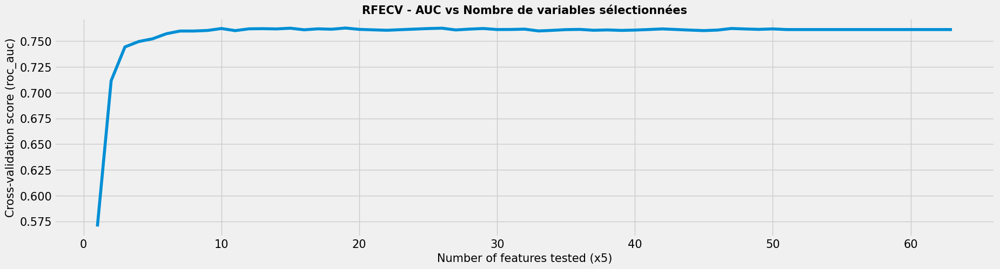

In [ ]:
step = 5
plt.figure(figsize=(20, 5))

plt.plot(range(1, len(rfecv.cv_results_['mean_test_score']) + 1),
         rfecv.cv_results_['mean_test_score'])

plt.xlabel('Number of features tested (x%d)' % step)
plt.ylabel('Cross-validation score (roc_auc)')
plt.title('RFECV - AUC vs Nombre de variables sélectionnées')
plt.grid(True)
plt.show()

In [ ]:
#X_data is very important to implement the feature importance plot...
X_data = data_train.loc[:, data_train.columns[rfecv.get_support()]]
X_data.shape

(307511, 91)

In [ ]:
X_data

,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_WORK_PHONE,...,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Core staff,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Transport: type 3,WALLSMATERIAL_MODE_Panel
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,
100002,0.090287,0.090032,0.077441,0.256321,0.888839,0.964437,0.852140,0.705433,0.098901,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100003,0.311736,0.132924,0.271605,0.045016,0.477114,0.933676,0.951929,0.959566,0.098901,0.0,...,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
100004,0.022472,0.020025,0.023569,0.134897,0.348534,0.987439,0.827335,0.648326,0.285714,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100006,0.066837,0.109477,0.063973,0.107023,0.350846,0.830337,0.601451,0.661387,0.098901,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100007,0.116854,0.078975,0.117845,0.392880,0.298591,0.830393,0.825268,0.519522,0.098901,0.0,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456251,0.052360,0.101176,0.046016,0.446855,0.896392,0.986824,0.657263,0.724607,0.098901,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
456252,0.056067,0.040505,0.046016,0.344429,0.251071,0.907995,0.822147,0.431708,0.098901,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
456253,0.157969,0.110618,0.135802,0.065247,0.578523,0.557782,0.726937,0.284424,0.098901,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
#Merge operation with TARGET before save this reduced sample
X_data = X_data.merge(TARGET, left_index=True, right_index=True)

In [ ]:
TARGET

,TARGET
SK_ID_CURR,
100002,1.0
100003,0.0
100004,0.0
100006,0.0
100007,0.0
...,...
456251,0.0
456252,0.0
456253,0.0


In [ ]:
X_data.shape


(307511, 92)

In [ ]:
X_data.to_csv('/content/drive/MyDrive/projet_7/X_data.csv', index=False)

In [ ]:
X_data.sample(30000).to_csv('/content/drive/MyDrive/projet_7/X_data_sample.csv', index=False)

In [ ]:
#Transform data with rfecv
X_train_selected = rfecv.transform(X_train)
X_test_selected = rfecv.transform(X_test)

In [ ]:
def train_models(model, X_train_selected, X_test_selected, y_train, y_test):
    models = [
          #Ensemble methods
          CatBoostClassifier(task_type="GPU", logging_level='Silent'),
          LGBMClassifier(device='gpu'),
          XGBClassifier(tree_method='gpu_hist', predictor='gpu_predictor')
          ]

    model.fit(X_train_selected, y_train)
    output = {
      'AUC': roc_auc_score(y_test, model.predict_proba(X_test_selected)[:,1]),
      'Accuracy': accuracy_score(y_test, model.predict(X_test_selected)),
      'Precision': precision_score(y_test, model.predict(X_test_selected)),
      'Recall': recall_score(y_test, model.predict(X_test_selected)),
      'F1': f1_score(y_test, model.predict(X_test_selected))
      }

    return output

In [ ]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()
    results = train_models(model, X_train_selected, X_test_selected, y_train, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
models_rfe = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
models_rfe.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
models_rfe.sort_values('AUC', ascending=False, inplace=True)

[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 16202
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 91
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 54 dense feature groups (11.50 MB) transferred to GPU in 0.008274 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
CPU times: user 33 s, sys: 3.26 s, total: 36.3 s
Wall time: 9.57 s


In [ ]:
#Models performance with features selection
models_rfe

,Model,AUC,Accuracy,Precision,Recall,F1,Time
1,LGBMClassifier,0.77633,0.920155,0.550756,0.034399,0.064754,2.906827
0,CatBoostClassifier,0.775897,0.920166,0.563492,0.028733,0.054678,5.508672
2,XGBClassifier,0.765841,0.918432,0.446565,0.063132,0.110625,1.153477


In [ ]:
###Reminder before… features selection
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,Time
1,LGBMClassifier,0.776229,0.920025,0.537313,0.033994,0.063943,9.207658
0,CatBoostClassifier,0.775353,0.920209,0.566327,0.029947,0.056887,82.554272
2,XGBClassifier,0.766638,0.918529,0.449951,0.062458,0.10969,3.272789


LGBMClassifier est le modèle le plus performant selon le couple AUC score/Time. CatBoostClassifier nécessite beaucoup plus de temps de calcul, il ne peut pas être retenu dans le contexte métier actuel. XGBClassifier est très rapide, il est en effet plus rapide que le LGBMClassifier mais avec une baisse de l'AUC score.

Dans la dernière partie de l'étude on développera les 3 volets suivants : La fonction coût, l'algorithme d'optimisation et la métrique d'évaluation.

La fonction coût sera déterminée par l'analyse des erreurs de prédiction
FP (False Positive) : les cas où la prédiction est positive, mais où la valeur réelle est négative.

Perte d'opportunité si le crédit client est refusé à tort, alors qu'il aurait été en mesure d'être remboursé.

FN (False Negative) : les cas où la prédiction est négative, mais où la valeur réelle est positive.

Perte réelle si le crédit client accepté se transforme en défaut de paiement.

Ainsi, les pertes d'un crédit en raison d'une mauvaise classification dépendront des probabilités Faux Positifs et Faux Négatifs.

L'idée est d'éviter les clients avec un fort risque de défaut. Il est donc nécessaire de pénaliser les FP et FN cités précédemment. Pour réduire ce rique de perte financière, il faut maximiser deux critères Recall et Precision.


 \begin{aligned}{\text{Precision}}&={\frac {tp}{tp+fp}}\\{\text{Recall}}&={\frac {tp}{tp+fn}}\,\end{aligned}

  
Fonction qui optimise Precision et Recall avec une importance plus forte pour le critère Precision:

 \begin{aligned}{\text{Fscore}}&={\frac {precision.recall}{Beta^2.precision + recall}}\,\end{aligned}
  
Avec Beta le coefficient d'importance relative au critère Precision par rapport au recall :


 \begin{aligned}{\text{Fscore}}&={\frac {precision.recall}{Beta^2.precision + recall}}\,&=(1+Beta^2) . {\frac {tp}{(1+Beta^2).tp + Beta^2.fn + fp}}\,\end{aligned}  

   

Explication sur la F-measure Wikipedia

L'application de cette métrique métier passe par la quantification de l'importance relative entre recall et précision, à savoir Beta (β). Cela revient à estimer le coût moyen d'un défaut, et le coût d'opportunité d'un client refusé par erreur. Cette connaissance métier n'est pas évoquée à ce stade du projet, nous allons donc l'estimer. Cette hypothèse pourra bien entendu être modifiée avec un interlocuteur métier.

Défaut de paiement 30% du montant du crédit en pertes et autres frais de recouvrement.
10% de chance d'obtenir un crédit pour un client lambda qui souhaite emprunter.



On peut se fixer l'hypothèse d'un Beta = 3. Vérifions-le avec une étape de tests fonctionnels.

In [ ]:
#Tests fonctionels avec des listes contenant 4 int: tp, tn, fp, fn
test_0 = [500, 300, 10, 30]
test_1 = [500, 300, 30, 10]
test_2 = [400, 300, 70, 50]
test_3 = [400, 300, 50, 70]
test_4 = [350, 250, 80, 120]
test_5 = [350, 250, 180, 90]

tests = [test_0, test_1, test_2, test_3, test_4, test_5]


def my_score(predictions_success: list) -> int:
    '''scoring fonction'''
    tp, tn, fp, fn = predictions_success

    beta = 3
    recall = tp / (tp + fn)
    precision = tp / (tp + fp)
    fscore = (1+beta)*(tp / ((1+3)*tp + beta*fn + fp))

    return 1-fscore

for i, t in enumerate(tests):
    print("############################")
    print("Test", i, ":", t)
    print("Score :", my_score(t))

############################
Test 0 : [500, 300, 10, 30]
Score : 0.04761904761904767
############################
Test 1 : [500, 300, 30, 10]
Score : 0.029126213592232997
############################
Test 2 : [400, 300, 70, 50]
Score : 0.1208791208791209
############################
Test 3 : [400, 300, 50, 70]
Score : 0.13978494623655913
############################
Test 4 : [350, 250, 80, 120]
Score : 0.23913043478260865
############################
Test 5 : [350, 250, 180, 90]
Score : 0.2432432432432432


In [ ]:
def custom_score(y_true, y_pred, beta=3) :
    '''function penalize fp and fn…'''
    tp, tn, fp, fn = confusion_matrix(y_true, y_pred).ravel()

    recall = tp / (tp + fn)
    precision = tp / (tp + fp)
    fscore = (1+beta)*((tp / ((1+beta)*tp + beta*fn + fp)))

    return 1-fscore

In [ ]:
def cost_false(model, y_true, X_true):
    '''Cost function analyzes prediction errors False Pos. and False Neg.'''
    cm = confusion_matrix(y_true, model.predict(X_true))
    FP = cm[0][1]/np.sum(cm)
    FN = cm[1][0]/np.sum(cm)

    print("False Pos: {0:.2%}".format(FP))
    print("False Neg: {0:.2%}".format(FN))
    return FP, FN

#Hyperparameters tunning - Hyperopt et AUC score


Choisir les hyperparamètres appropriés est nécessaire pour affiner et booster les performances d'un algorithme d’apprentissage automatique. La métrique utilisée dans le contexte de notre classification binaire sera l'AUC score.

Grid Search ou Random Search étaient également une alternative possible, à la différence d'Hyperopt une "méthode basique" ne permet pas de traiter un large espace de paramètres, ici très largement privilégié.

Avec Hyperopt, on peut facilement analyser notre modèle de Boosting tout en variant les hyperparamètres dans l'espace que nous allons définir ci-dessous. Hyperopt fonctionne avec les algorithmes de ML distribué, comme Apache Spark MLlib et Horovod, ainsi qu’avec les modèles ML mono-machine, comme scikit-learn et TensorFlow.

In [ ]:
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, space_eval


In [ ]:
#Parameter space
space = {
    'n_estimators': hp.quniform('n_estimators', 100, 600, 100),
    'learning_rate': hp.uniform('learning_rate', 0.001, 0.03),
    'max_depth': hp.quniform('max_depth', 3, 7, 1),
    'subsample': hp.uniform('subsample', 0.60, 0.95),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.60, 0.95),
    'reg_lambda': hp.uniform('reg_lambda', 1, 20)
    }

In [ ]:
def objective(params, eval_metric='custom_score'):
    #objective function to be minimized.
    #Hyperopt will seek to minimize the loss returned by this function.

    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda'],
        'device':'gpu'
        }


    model= LGBMClassifier(**params)
    cv = StratifiedKFold(5)
    if eval_metric == 'roc_auc':
        score = cross_val_score(model, X_train_selected, y_train, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'custom_score':
        y_pred = cross_val_predict(model, X_train_selected, y_train, method='predict', cv=cv)
        score = custom_score(y_train, y_pred)

    loss = 1 - score
    return {'loss': loss, 'params': params, 'status': STATUS_OK}

In [ ]:
%%time
best = fmin(fn=objective, space=space, max_evals=30, rstate=np.random.default_rng(42), algo=tpe.suggest)

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 13930, number of negative: 158276
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 16192
[LightGBM] [Info] Number of data points in the train set: 172206, number of used features: 91
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 54 dense feature groups (9.20 MB) transferred to GPU in 0.009360 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080891 -> initscore=-2.430296
[LightGBM] [Info] Start traini

In [ ]:
%%time
lgbm = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best['n_estimators']),
    colsample_bytree= best['colsample_bytree'],
    learning_rate= best['learning_rate'],
    max_depth= int(best['max_depth']),
    subsample= best['subsample'],
    reg_lambda= best['reg_lambda'],
    device='gpu')

lgbm.fit(X_train_selected, y_train)
payload = {
    "selector": rfecv,
    "model": lgbm,
    "feature_order": selected_cols,   # <-- clé importante
    # optionnel mais utile :
    "n_features_": len(selected_cols),
    "all_columns_at_fit": list(X_train.columns),
}

with open("/content/drive/MyDrive/projet_7/LGBMClassifier.pkl", "wb") as f:
    pickle.dump(payload, f)

[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 16202
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 91
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 54 dense feature groups (11.50 MB) transferred to GPU in 0.010729 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
CPU times: user 42.4 s, sys: 275 ms, total: 42.7 s
Wall time: 8.63 s


## test du model

In [ ]:
roc_auc = roc_auc_score(y_test, lgbm.predict_proba(X_test_selected)[:,1])
print('AUC : %0.6f' %roc_auc)

AUC : 0.781529


In [ ]:
print(data_test.columns.tolist())

['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAR

In [ ]:
data_test = data_test.drop("SK_ID_CURR", axis=1)

In [ ]:
data_test.shape

(48744, 311)

In [ ]:
selector.transform(data_test)

NameError: name 'selector' is not defined

In [ ]:
classifier = modele["model"]
df_result = classifier.predict_proba(selector.transform(data_test))

NameError: name 'modele' is not defined

In [ ]:
df_result.shape

In [ ]:
roc_auc = roc_auc_score(y_test, modele.predict_proba(X_test_selected)[:,1])
print('AUC : %0.6f' %roc_auc)

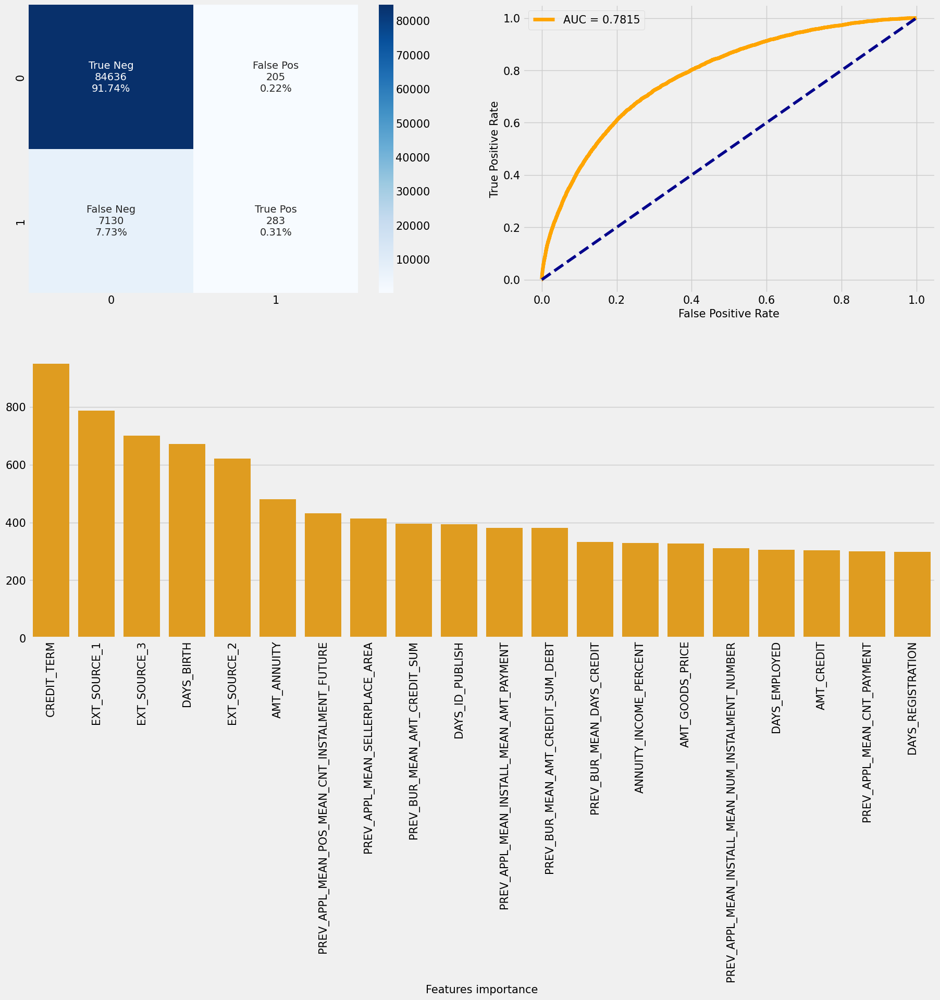

In [ ]:
cf_matrix_roc_auc(lgbm, y_test, lgbm.predict(X_test_selected), lgbm.predict_proba(X_test_selected)[:,1], feature_importances=True)


In [ ]:
#FP and FN
cost_false(lgbm, y_test, X_test_selected)

False Pos: 0.22%
False Neg: 7.73%


(np.float64(0.0022221258698809808), np.float64(0.07728662171829948))

In [ ]:
#Check list features importance
sorted_idx = np.argsort(lgbm.feature_importances_)[::-1]
for index in sorted_idx:
    print([X_data.columns[index], lgbm.feature_importances_[index]])

['CREDIT_TERM', np.int32(948)]
['EXT_SOURCE_1', np.int32(787)]
['EXT_SOURCE_3', np.int32(701)]
['DAYS_BIRTH', np.int32(671)]
['EXT_SOURCE_2', np.int32(620)]
['AMT_ANNUITY', np.int32(481)]
['PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', np.int32(431)]
['PREV_APPL_MEAN_SELLERPLACE_AREA', np.int32(414)]
['PREV_BUR_MEAN_AMT_CREDIT_SUM', np.int32(395)]
['DAYS_ID_PUBLISH', np.int32(394)]
['PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', np.int32(382)]
['PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', np.int32(382)]
['PREV_BUR_MEAN_DAYS_CREDIT', np.int32(332)]
['ANNUITY_INCOME_PERCENT', np.int32(329)]
['AMT_GOODS_PRICE', np.int32(327)]
['PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', np.int32(311)]
['DAYS_EMPLOYED', np.int32(305)]
['AMT_CREDIT', np.int32(303)]
['PREV_APPL_MEAN_CNT_PAYMENT', np.int32(300)]
['DAYS_REGISTRATION', np.int32(298)]
['PREV_APPL_MEAN_POS_MEAN_SK_DPD_DEF', np.int32(286)]
['DAYS_LAST_PHONE_CHANGE', np.int32(274)]
['PREV_BUR_MEAN_DAYS_CREDIT_ENDDATE', np.int32(267)]
['DAYS_EMPLOYED

In [ ]:
def objective(params, eval_metric='roc_auc'):
  #objective function to be minimized.
  #Hyperopt will seek to minimize the loss returned by this function.

    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda'],
        'device':'gpu'}


    model= LGBMClassifier(**params)
    cv = StratifiedKFold(5)
    if eval_metric == 'roc_auc':
        score = cross_val_score(model, X_train_selected, y_train, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'custom_score':
        y_pred = cross_val_predict(model, X_train_selected, y_train, method='predict', cv=cv)
        score = custom_score(y_train, y_pred)

    loss = 1 - score
    return {'loss': loss, 'params': params, 'status': STATUS_OK}

In [ ]:
%%time
best = fmin(fn=objective, space=space, max_evals=30, rstate=np.random.default_rng(42), algo=tpe.suggest)

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 13930, number of negative: 158276
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 16192
[LightGBM] [Info] Number of data points in the train set: 172206, number of used features: 91
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] G

In [ ]:
%%time
lgbm = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best['n_estimators']),
    colsample_bytree= best['colsample_bytree'],
    learning_rate= best['learning_rate'],
    max_depth= int(best['max_depth']),
    subsample= best['subsample'],
    reg_lambda= best['reg_lambda'],
    device='gpu')

lgbm.fit(X_train_selected, y_train)
#pickle.dump(lgbm, open("/content/gdrive/My Drive/Colab Notebooks/p7_00_models/LGBMClassifier.pkl", "wb"))

[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 16202
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 91
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 54 dense feature groups (11.50 MB) transferred to GPU in 0.010328 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
CPU times: user 43.5 s, sys: 288 ms, total: 43.8 s
Wall time: 7.95 s


LGBMClassifier(colsample_bytree=np.float64(0.9364891976997402), device='gpu',
               learning_rate=np.float64(0.026117694457256667), max_depth=7,
               n_estimators=600, reg_lambda=np.float64(8.502096885942658),
               subsample=np.float64(0.9162056299840865))

In [ ]:
roc_auc = roc_auc_score(y_test, lgbm.predict_proba(X_test_selected)[:,1])
print('AUC : %0.6f' %roc_auc)

AUC : 0.781529


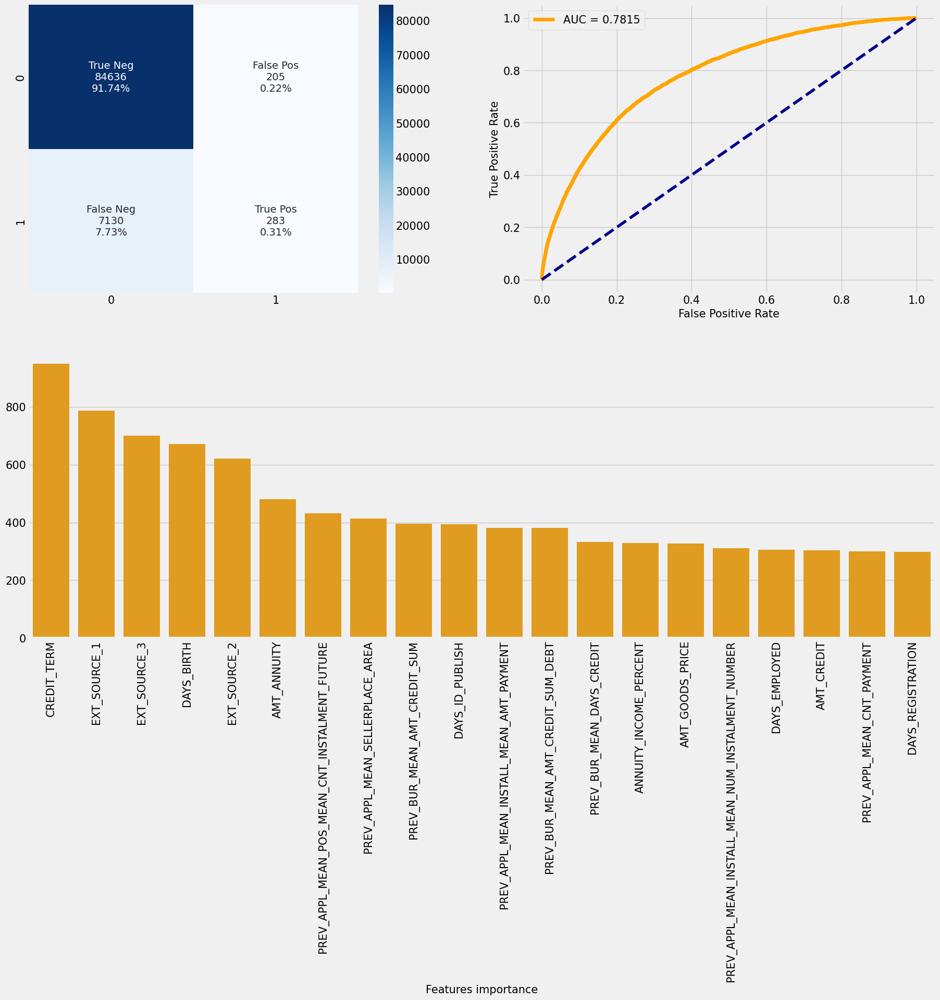

In [ ]:
cf_matrix_roc_auc(lgbm, y_test, lgbm.predict(X_test_selected), lgbm.predict_proba(X_test_selected)[:,1], feature_importances=True)


In [ ]:
#FP and FN
cost_false(lgbm, y_test, X_test_selected)

False Pos: 0.22%
False Neg: 7.73%


(np.float64(0.0022221258698809808), np.float64(0.07728662171829948))

In [ ]:
#Check list features importance
sorted_idx = np.argsort(lgbm.feature_importances_)[::-1]
for index in sorted_idx:
    print([X_data.columns[index], lgbm.feature_importances_[index]])

['CREDIT_TERM', np.int32(948)]
['EXT_SOURCE_1', np.int32(787)]
['EXT_SOURCE_3', np.int32(701)]
['DAYS_BIRTH', np.int32(671)]
['EXT_SOURCE_2', np.int32(620)]
['AMT_ANNUITY', np.int32(480)]
['PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', np.int32(431)]
['PREV_APPL_MEAN_SELLERPLACE_AREA', np.int32(414)]
['PREV_BUR_MEAN_AMT_CREDIT_SUM', np.int32(395)]
['DAYS_ID_PUBLISH', np.int32(394)]
['PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', np.int32(382)]
['PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', np.int32(382)]
['PREV_BUR_MEAN_DAYS_CREDIT', np.int32(332)]
['ANNUITY_INCOME_PERCENT', np.int32(329)]
['AMT_GOODS_PRICE', np.int32(327)]
['PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', np.int32(311)]
['DAYS_EMPLOYED', np.int32(305)]
['AMT_CREDIT', np.int32(304)]
['PREV_APPL_MEAN_CNT_PAYMENT', np.int32(300)]
['DAYS_REGISTRATION', np.int32(298)]
['PREV_APPL_MEAN_POS_MEAN_SK_DPD_DEF', np.int32(286)]
['DAYS_LAST_PHONE_CHANGE', np.int32(274)]
['PREV_BUR_MEAN_DAYS_CREDIT_ENDDATE', np.int32(267)]
['DAYS_EMPLOYED

**Conclusion**  
Après une baseline faite avec un algorithme simple de régression logistique, l'AUC score avait été estimé ≈ 0.72 avec rééquilibrage (SMOTE) des données. La suite de l'étude a été déroulée vers 3 algorithmes plus complexes de gradient boosting implémentés par LightGbm vs CatBoost vs XGBoost. Nous avons pu démontrer les performances de ces algorithmes par une sélection de features, à l'origine > 300, après RFECV 149. LightGbm ressort comme étant le plus rapide, le plus performant sur la métrique classique de l'AUC, il a donc été choisi pour l'optimisation des Hyperparamètres (Hyperopt).  
  
La fonction coût permet de pénaliser les erreurs de prédiction qui peuvent coûter cher à l'entreprise. En effet, avec l'implémentation de la métrique métier les FP sont estimés à 0.19% (contre 0.21%), les FN sont à 0.78% (contre 0.77%). Au final la métrique métier permet de pénaliser légèrement mieux les erreurs du modèle.

# Reduction du nombres de feature avec feature importance

In [ ]:
with open("/content/drive/MyDrive/projet_7/LGBMClassifier.pkl", "rb") as f:
    payload = pickle.load(f)

selector = payload["selector"]
model = payload["model"]
feature_order = payload["feature_order"]
n_features = payload.get("n_features_")
all_columns = payload.get("all_columns_at_fit")

In [ ]:
# Importance du modèle (alignée avec les colonnes d’entraînement du modèle)
imp = pd.DataFrame({
    "feature": feature_order,                         # mêmes colonnes que pour le fit
    "importance": model.feature_importances_
}).sort_values("importance", ascending=False)


In [ ]:
imp.shape

(20, 2)

In [ ]:
print(imp.head(20))

                                              feature  importance
0                                         CREDIT_TERM        1814
1                                        EXT_SOURCE_1        1231
3                                          DAYS_BIRTH        1192
2                                        EXT_SOURCE_3        1125
4                                        EXT_SOURCE_2        1121
6       PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE        1035
8                        PREV_BUR_MEAN_AMT_CREDIT_SUM         924
11            PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT         896
16                                      DAYS_EMPLOYED         861
7                     PREV_APPL_MEAN_SELLERPLACE_AREA         802
5                                         AMT_ANNUITY         790
13                             ANNUITY_INCOME_PERCENT         748
15  PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER         744
9                                     DAYS_ID_PUBLISH         741
12        

In [ ]:
imp.to_csv('/content/drive/MyDrive/projet_7/df_features_importance.csv', index=False)

In [ ]:
top20 = imp.head(20).reset_index(drop=True)
top20_features = top20["feature"].tolist()
print(top20)
print(top20_features)

                                              feature  importance
0                                         CREDIT_TERM        1814
1                                        EXT_SOURCE_1        1231
2                                          DAYS_BIRTH        1192
3                                        EXT_SOURCE_3        1125
4                                        EXT_SOURCE_2        1121
5       PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE        1035
6                        PREV_BUR_MEAN_AMT_CREDIT_SUM         924
7             PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT         896
8                                       DAYS_EMPLOYED         861
9                     PREV_APPL_MEAN_SELLERPLACE_AREA         802
10                                        AMT_ANNUITY         790
11                             ANNUITY_INCOME_PERCENT         748
12  PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER         744
13                                    DAYS_ID_PUBLISH         741
14        

In [ ]:
# On ne garde que celles présentes dans data_train
cols = [c for c in top20_features if c in data_train.columns]
missing = [c for c in top20_features if c not in data_train.columns]

data_train_fi= data_train.loc[:, cols].copy()

if missing:
    print("Colonnes absentes ignorées :", missing)

In [ ]:
data_train_fi

,CREDIT_TERM,EXT_SOURCE_1,DAYS_BIRTH,EXT_SOURCE_3,EXT_SOURCE_2,PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE,PREV_BUR_MEAN_AMT_CREDIT_SUM,PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT,DAYS_EMPLOYED,PREV_APPL_MEAN_SELLERPLACE_AREA,AMT_ANNUITY,ANNUITY_INCOME_PERCENT,PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER,DAYS_ID_PUBLISH,PREV_BUR_MEAN_DAYS_CREDIT,PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT,DAYS_REGISTRATION,AMT_GOODS_PRICE,PREV_APPL_MEAN_CNT_PAYMENT,AMT_CREDIT
0,0.377861,0.072215,0.111161,0.155054,0.307542,0.250000,0.000546,0.004609,0.964437,0.000125,0.090032,0.064910,0.097317,0.705433,0.700890,0.025323,0.852140,0.077441,0.333333,0.090287
1,0.053985,0.312933,0.522886,0.597163,0.727773,0.094444,0.001284,0.031360,0.933676,0.000133,0.132924,0.070368,0.039648,0.959566,0.520619,0.024224,0.951929,0.271605,0.138889,0.311736
2,0.272843,0.518318,0.651466,0.814130,0.650190,0.037500,0.000477,0.002827,0.987439,0.000008,0.020025,0.053193,0.010813,0.648326,0.703285,0.024224,0.827335,0.023569,0.055556,0.022472
3,0.711908,0.518318,0.649154,0.597163,0.760751,0.170238,0.000987,0.096595,0.830337,0.000224,0.109477,0.117114,0.023428,0.661387,0.640462,0.025212,0.601451,0.063973,0.319444,0.066837
4,0.200770,0.518318,0.701409,0.597163,0.377472,0.149444,0.000738,0.004654,0.830393,0.000103,0.078975,0.095823,0.063191,0.519522,0.606776,0.024224,0.825268,0.117845,0.287037,0.116854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.841421,0.138170,0.103608,0.597163,0.797231,0.072917,0.000987,0.002985,0.986824,0.000008,0.101176,0.093162,0.032439,0.724607,0.640462,0.025212,0.657263,0.046016,0.111111,0.052360
307507,0.219346,0.518318,0.748929,0.597163,0.135663,0.050000,0.000987,0.004014,0.907995,0.000048,0.040505,0.088746,0.027032,0.431708,0.640462,0.025212,0.822147,0.046016,0.083333,0.056067
307508,0.216557,0.769370,0.421477,0.243815,0.626575,0.038889,0.004998,0.001740,0.557782,0.000006,0.110618,0.104341,0.022167,0.284424,0.703114,0.034260,0.726937,0.135802,0.069444,0.157969
307509,0.317709,0.518318,0.252086,0.737587,0.601360,0.175000,0.000227,0.004258,0.732805,0.000395,0.072499,0.062873,0.045955,0.870641,0.622177,0.024224,0.896158,0.069585,0.208333,0.081175


In [ ]:
feature_names_fi = data_train_fi.columns
print(len(feature_names_fi))
X_train_fi, X_test_fi, y_train_fi, y_test_fi = train_test_split(data_train_fi.values, TARGET.values, test_size=0.3, random_state=42)

20


In [ ]:
%%time
lr_fi = LogisticRegression(C = 0.0001, max_iter=100)
lr_fi.fit(X_train_fi, y_train_fi)
roc_auc_fi = roc_auc_score(y_test_fi, lr_fi.predict_proba(X_test_fi)[:,1])
print('AUC : %0.4f' %roc_auc_fi)
print(classification_report(y_test_fi, lr_fi.predict(X_test_fi)))

AUC : 0.7154
              precision    recall  f1-score   support

         0.0       0.92      1.00      0.96     84841
         1.0       0.00      0.00      0.00      7413

    accuracy                           0.92     92254
   macro avg       0.46      0.50      0.48     92254
weighted avg       0.85      0.92      0.88     92254

CPU times: user 5.47 s, sys: 0 ns, total: 5.47 s
Wall time: 470 ms


## SMOTE

In [ ]:
print("Label 1, Before using SMOTE: {} ".format(sum(y_train_fi==1)))
print("Label 0, Before using SMOTE: {} ".format(sum(y_train_fi==0)))

Label 1, Before using SMOTE: 17412 
Label 0, Before using SMOTE: 197845 


In [ ]:
%%time
sm_fi = SMOTE(random_state=2)
X_train_res_fi, y_train_res_fi = sm_fi.fit_resample(X_train_fi, y_train_fi)

CPU times: user 1.74 s, sys: 1.01 ms, total: 1.74 s
Wall time: 387 ms


In [ ]:
print("Label 1, After using SMOTE: {}".format(sum(y_train_res_fi==1)))
print("Label 0, After using SMOTE: {}".format(sum(y_train_res_fi==0)))

Label 1, After using SMOTE: 197845
Label 0, After using SMOTE: 197845


In [ ]:
%%time
lr_fi = LogisticRegression(C = 0.0001, max_iter=100)
lr_fi.fit(X_train_res_fi, y_train_res_fi)
roc_auc_fi = roc_auc_score(y_test_fi , lr_fi.predict_proba(X_test_fi)[:,1])
print('AUC : %0.4f' %roc_auc_fi)
print(classification_report(y_test_fi, lr_fi.predict(X_test_fi)))

AUC : 0.7192
              precision    recall  f1-score   support

         0.0       0.96      0.68      0.80     84841
         1.0       0.15      0.64      0.24      7413

    accuracy                           0.68     92254
   macro avg       0.55      0.66      0.52     92254
weighted avg       0.89      0.68      0.75     92254

CPU times: user 9.06 s, sys: 0 ns, total: 9.06 s
Wall time: 781 ms


##RFECV

In [ ]:
%%time
start = time.time()

rfecv_fi = RFECV(
    estimator=LGBMClassifier(objective="binary", n_estimators=200, random_state=42),
    step=1,
    cv=StratifiedKFold(5, shuffle=True, random_state=42),
    scoring="roc_auc",
    n_jobs=-1
)

# Si X_train est un array mais que tu as encore les noms des colonnes :
X_train_fi = pd.DataFrame(X_train_fi, columns=feature_names_fi)
print(X_train_fi.shape)

rfecv_fi.fit(X_train_fi, y_train_fi)
selected_cols = list(X_train_fi.columns[rfecv_fi.get_support()])
print(len(selected_cols))
print(selected_cols)


print('Time Elapsed: {:.2f} seconds'.format(time.time() - start))

(215257, 20)
[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5088
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5088
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.43

In [ ]:
print("Optimal number of features : %d" % rfecv_fi.n_features_)
print("Selected Features: %s" % rfecv_fi.support_[:20])
print("Feature Ranking : %s" % rfecv_fi.ranking_[:20])

Optimal number of features : 20
Selected Features: [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True]
Feature Ranking : [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [ ]:
ranking_fi = pd.DataFrame({'Features': data_train_fi.columns})
ranking_fi['RANK'] = np.asarray(rfecv_fi.ranking_)
ranking_fi.sort_values('RANK', inplace=True)

features_selection_fi = ranking_fi [ranking_fi.RANK == 1]['Features'].to_list()
print(len(features_selection_fi))
print(features_selection_fi)

20
['CREDIT_TERM', 'EXT_SOURCE_1', 'DAYS_BIRTH', 'EXT_SOURCE_3', 'EXT_SOURCE_2', 'PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', 'PREV_BUR_MEAN_AMT_CREDIT_SUM', 'PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', 'DAYS_EMPLOYED', 'PREV_APPL_MEAN_SELLERPLACE_AREA', 'AMT_ANNUITY', 'ANNUITY_INCOME_PERCENT', 'PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', 'DAYS_ID_PUBLISH', 'PREV_BUR_MEAN_DAYS_CREDIT', 'PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', 'DAYS_REGISTRATION', 'AMT_GOODS_PRICE', 'PREV_APPL_MEAN_CNT_PAYMENT', 'AMT_CREDIT']


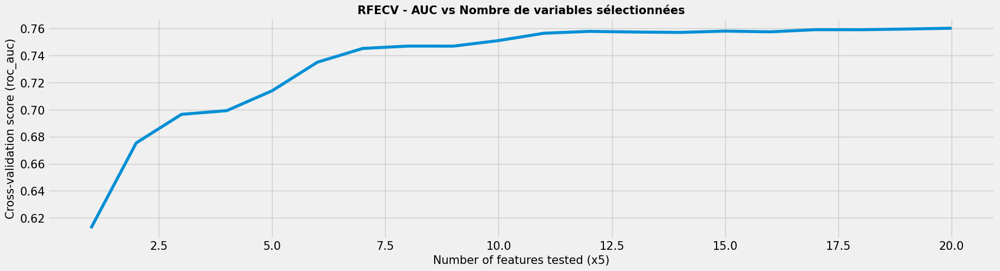

In [ ]:
step = 5
plt.figure(figsize=(20, 5))

plt.plot(range(1, len(rfecv_fi.cv_results_['mean_test_score']) + 1),
         rfecv_fi.cv_results_['mean_test_score'])

plt.xlabel('Number of features tested (x%d)' % step)
plt.ylabel('Cross-validation score (roc_auc)')
plt.title('RFECV - AUC vs Nombre de variables sélectionnées')
plt.grid(True)
plt.show()

In [ ]:
#Transform data with rfecv
X_train_selected_fi = rfecv_fi.transform(X_train_fi)
X_test_selected_fi = rfecv_fi.transform(X_test_fi)

In [ ]:
#Parameter space
space = {
    'n_estimators': hp.quniform('n_estimators', 100, 600, 100),
    'learning_rate': hp.uniform('learning_rate', 0.001, 0.03),
    'max_depth': hp.quniform('max_depth', 3, 7, 1),
    'subsample': hp.uniform('subsample', 0.60, 0.95),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.60, 0.95),
    'reg_lambda': hp.uniform('reg_lambda', 1, 20)
    }

In [ ]:
def objective_fi(params, eval_metric='custom_score'):
    #objective function to be minimized.
    #Hyperopt will seek to minimize the loss returned by this function.

    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda'],
        'device':'gpu'
        }


    model= LGBMClassifier(**params)
    cv = StratifiedKFold(5)
    if eval_metric == 'roc_auc':
        score = cross_val_score(model, X_train_selected_fi, y_train_fi, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'custom_score':
        y_pred_fi = cross_val_predict(model, X_train_selected_fi, y_train_fi, method='predict', cv=cv)
        score = custom_score(y_train_fi, y_pred_fi)

    loss = 1 - score
    return {'loss': loss, 'params': params, 'status': STATUS_OK}

In [ ]:
%%time
best_fi = fmin(fn=objective_fi, space=space, max_evals=30, rstate=np.random.default_rng(42), algo=tpe.suggest)

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 20 dense feature groups (3.28 MB) transferred to GPU in 0.005829 secs. 0 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080891 -> initscore=-2.430296
[LightGBM] [Info] Start training from score -2.430296
[LightGBM] [Info] Number of positive: 13929, number of negative: 158276
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5085
[LightGBM] [Info] Number of data points in the train set: 172205, number of used features: 20
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 20 dense feature groups (3.28 MB) transferred to GPU in 0.005947 secs. 0 sparse feature 

In [ ]:
%%time
lgbm = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best_fi['n_estimators']),
    colsample_bytree= best_fi['colsample_bytree'],
    learning_rate= best_fi['learning_rate'],
    max_depth= int(best_fi['max_depth']),
    subsample= best_fi['subsample'],
    reg_lambda= best_fi['reg_lambda'],
    device='gpu')

lgbm.fit(X_train_fi, y_train_fi)
payload = {
    "selector": rfecv_fi,
    "model": lgbm,
    "feature_order": selected_cols,   # <-- clé importante
    # optionnel mais utile :
    "n_features_": len(selected_cols),
    "all_columns_at_fit": list(X_train_fi.columns),
}

with open("/content/drive/MyDrive/projet_7/LGBMClassifier.pkl", "wb") as f:
    pickle.dump(payload, f)

[LightGBM] [Info] Number of positive: 17412, number of negative: 197845
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5087
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 20
[LightGBM] [Info] Using GPU Device: NVIDIA L4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 20 dense feature groups (4.11 MB) transferred to GPU in 0.006462 secs. 0 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.080889 -> initscore=-2.430324
[LightGBM] [Info] Start training from score -2.430324
CPU times: user 25.2 s, sys: 203 ms, total: 25.4 s
Wall time: 4.42 s


# Pipeline

Creation du pipeline final pour l'application

## Import

In [ ]:
!pip install catboost


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 8.5 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd

import time, pickle

from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OrdinalEncoder, MinMaxScaler, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, recall_score
from sklearn.metrics import classification_report, confusion_matrix, roc_curve
from sklearn.base import BaseEstimator, ClassifierMixin, clone
from sklearn.calibration import CalibratedClassifierCV
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTENC, SMOTE
from lightgbm import LGBMClassifier

import matplotlib.pyplot as plt
import seaborn as sns


from hyperopt import fmin, tpe, hp, Trials, STATUS_OK, space_eval

## Chargement des données

In [ ]:
#Download files from google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
data_test_app = pd.read_csv('/content/drive/MyDrive/projet_7/data_test_app.csv')


In [ ]:
data_test_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 191 entries, SK_ID_CURR to DAYS_EMPLOYED_PERCENT
dtypes: bool(1), float64(135), int64(39), object(16)
memory usage: 70.7+ MB


In [ ]:
data_train_app = pd.read_csv('/content/drive/MyDrive/projet_7/data_train_app.csv')
df_feature_importance = pd.read_csv('/content/drive/MyDrive/projet_7/df_features_importance.csv')

## feature importance

In [ ]:
top20_features = df_feature_importance.head(20)["feature"].tolist()
top20_features.append("TARGET")
print(top20_features)
print(len(top20_features))

['CREDIT_TERM', 'EXT_SOURCE_1', 'DAYS_BIRTH', 'EXT_SOURCE_3', 'EXT_SOURCE_2', 'PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', 'PREV_BUR_MEAN_AMT_CREDIT_SUM', 'PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', 'DAYS_EMPLOYED', 'PREV_APPL_MEAN_SELLERPLACE_AREA', 'AMT_ANNUITY', 'ANNUITY_INCOME_PERCENT', 'PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', 'DAYS_ID_PUBLISH', 'PREV_BUR_MEAN_DAYS_CREDIT', 'PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', 'DAYS_REGISTRATION', 'AMT_GOODS_PRICE', 'PREV_APPL_MEAN_CNT_PAYMENT', 'AMT_CREDIT', 'TARGET']
21


In [ ]:
top20_features = df_feature_importance.head(20)["feature"].tolist()
top20_features.append("TARGET")
print("List before removing the last element:", top20_features)
print(len(top20_features))

List before removing the last element: ['CREDIT_TERM', 'EXT_SOURCE_1', 'DAYS_BIRTH', 'EXT_SOURCE_3', 'EXT_SOURCE_2', 'PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', 'PREV_BUR_MEAN_AMT_CREDIT_SUM', 'PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', 'DAYS_EMPLOYED', 'PREV_APPL_MEAN_SELLERPLACE_AREA', 'AMT_ANNUITY', 'ANNUITY_INCOME_PERCENT', 'PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', 'DAYS_ID_PUBLISH', 'PREV_BUR_MEAN_DAYS_CREDIT', 'PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', 'DAYS_REGISTRATION', 'AMT_GOODS_PRICE', 'PREV_APPL_MEAN_CNT_PAYMENT', 'AMT_CREDIT', 'TARGET']
21


In [ ]:
# On ne garde que celles présentes dans data_train
cols = [c for c in top20_features if c in data_train_app.columns]
missing = [c for c in top20_features if c not in data_train_app.columns]

data_train_app_top= data_train_app.loc[:, cols].copy()

if missing:
    print("Colonnes absentes ignorées :", missing)

In [ ]:
top20_features.pop()
print(top20_features)
print(len(top20_features))

['CREDIT_TERM', 'EXT_SOURCE_1', 'DAYS_BIRTH', 'EXT_SOURCE_3', 'EXT_SOURCE_2', 'PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE', 'PREV_BUR_MEAN_AMT_CREDIT_SUM', 'PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT', 'DAYS_EMPLOYED', 'PREV_APPL_MEAN_SELLERPLACE_AREA', 'AMT_ANNUITY', 'ANNUITY_INCOME_PERCENT', 'PREV_APPL_MEAN_INSTALL_MEAN_NUM_INSTALMENT_NUMBER', 'DAYS_ID_PUBLISH', 'PREV_BUR_MEAN_DAYS_CREDIT', 'PREV_BUR_MEAN_AMT_CREDIT_SUM_DEBT', 'DAYS_REGISTRATION', 'AMT_GOODS_PRICE', 'PREV_APPL_MEAN_CNT_PAYMENT', 'AMT_CREDIT']
20


In [ ]:
target_col = "TARGET"
X = data_train_app_top.drop(columns=[target_col])
y = data_train_app_top[target_col]

In [ ]:
label_encoder_y = LabelEncoder()
y_enc = label_encoder_y.fit_transform(y)
n_classes = len(np.unique(y_enc))

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y_enc, test_size=0.2, stratify=y_enc, random_state=42
)
num_cols = X_train.select_dtypes(include=["number"]).columns.tolist()
cat_cols = X_train.select_dtypes(include=["object", "category", "bool"]).columns.tolist()


In [ ]:
cat_idx_after_ct = list(range(len(num_cols), len(num_cols) + len(cat_cols)))

## Preprocess pipeline

In [ ]:
def build_preprocess():
    """Reconstruit un preprocess neuf à chaque essai (évite tout état fitté)."""
    num_pipe = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="median")),
        ("scaler", MinMaxScaler())
    ])
    cat_pipe = Pipeline(steps=[
        ("imputer", SimpleImputer(strategy="most_frequent")),
        ("encoder", OrdinalEncoder(handle_unknown="use_encoded_value", unknown_value=-1))
    ])
    return ColumnTransformer(
        transformers=[
            ("num", num_pipe, num_cols),
            ("cat", cat_pipe, cat_cols),
        ],
        remainder="drop"
    )

## SMOTE

**1) Problème de départ**  
Gestion des faux négatifs ( mauvais client prédit en bon client ) et faux positifs (bon client prédit en mavais)
Classe 0 = accord crédit (bon client)

Classe 1 = refus crédit (mauvais client)
En général, on a beaucoup plus de bons que de mauvais clients → fort déséquilibre.

Si on entraîne directement, le modèle risque de prédire quasiment toujours "bon client", obtenir une accuracy artificiellement haute, mais rater l’identification des mauvais clients (FN coûteux pour la banque).

**2) Principe de SMOTE**

SMOTE est une méthode de sur-échantillonnage synthétique de la minorité (ici, les "mauvais clients").

🔹 Plutôt que de recopier bêtement des exemples minoritaires (oversampling naïf), SMOTE crée de nouveaux points artificiels en interpolant entre un exemple minoritaire et ses k plus proches voisins minoritaires.

Exemple simplifié :

Suppose que deux "mauvais clients" existent à
[
2
,
3
]
[2,3] et
[
3
,
4
]
[3,4].

SMOTE peut générer un point intermédiaire comme
[
2.6
,
3.5
]
[2.6,3.5].

Résultat : la classe minoritaire devient plus dense et mieux représentée dans l’espace des features.

**3) Avantages de SMOTE**

✅ Évite le simple clonage des données → moins de sur-apprentissage.
✅ Fournit plus de "variété" à la minorité.
✅ Améliore souvent la sensibilité (recall) de la classe rare (ici, mauvais clients).

**4) Limites de SMOTE**

⚠️ Interpolation linéaire → peut générer des points non réalistes (surtout si tes variables sont catégorielles).
⚠️ Peut créer des overlaps entre classes si les frontières sont complexes → risque d’augmenter les faux positifs.
⚠️ Ne corrige pas à lui seul le coût métier : il équilibre la distribution, mais ne reflète pas que un FN = 10× un FP.

**5) Variantes de SMOTE**

Il existe plusieurs variantes utiles :

Borderline-SMOTE : ne génère que près des frontières de décision, là où c’est le plus utile.

SMOTEENN / SMOTETomek : combinent sur-échantillonnage (SMOTE) + nettoyage des exemples ambigus (ENN = Edited Nearest Neighbors, Tomek links).

ADASYN : crée plus de points artificiels là où la minorité est sous-représentée localement.

👉 Dans le crédit, Borderline-SMOTE ou SMOTEENN donnent souvent de meilleurs résultats qu’un SMOTE “pur”.

In [ ]:
def build_sampler():
    """SMOTE pour num uniquement, ou SMOTENC si cat présente (plus sûr)."""
    if len(cat_cols) > 0:
        return SMOTENC(
            categorical_features=cat_idx_after_ct,
            random_state=42,
            k_neighbors=2    # valeur prudente pour éviter les erreurs quand la classe minoritaire est très petite
        )
    else:
        return SMOTE(random_state=42, k_neighbors=2)


## Hyperopt

In [ ]:
##space = {
#    "num_leaves":        hp.quniform("num_leaves", 15, 255, 1),
#    "max_depth":         hp.choice("max_depth", [-1, 4, 5, 6, 7, 8, 9, 10, 12]),
#    "learning_rate":     hp.loguniform("learning_rate", np.log(0.005), np.log(0.2)),
#    "n_estimators":      hp.quniform("n_estimators", 100, 1200, 50),
#    "min_child_samples": hp.quniform("min_child_samples", 5, 200, 1),
#    "subsample":         hp.uniform("subsample", 0.5, 1.0),         # bagging_fraction
#    "colsample_bytree":  hp.uniform("colsample_bytree", 0.5, 1.0),  # feature_fraction
#    "reg_alpha":         hp.loguniform("reg_alpha", np.log(1e-8), np.log(10.0)),
#    "reg_lambda":        hp.loguniform("reg_lambda", np.log(1e-8), np.log(10.0)),
#}

In [ ]:
space = {
    'num_leaves':        hp.quniform("num_leaves", 15, 255, 1),
    'n_estimators': hp.quniform('n_estimators', 100, 600, 100),
    'learning_rate': hp.uniform('learning_rate', 0.001, 0.03),
    'max_depth': hp.quniform('max_depth', 3, 7, 1),
    'subsample': hp.uniform('subsample', 0.60, 0.95),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.60, 0.95),
    'reg_lambda': hp.uniform('reg_lambda', 1, 20)
    }

In [ ]:
scoring = "roc_auc" if n_classes == 2 else "roc_auc_ovr_weighted"
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


In [ ]:
def objective(hparams):
    # cast des entiers
    hparams = dict(hparams)
    hparams["num_leaves"]        = int(hparams["num_leaves"])
    hparams["n_estimators"]      = int(hparams["n_estimators"])

    # modèle LGBM
    clf = LGBMClassifier(
        objective="binary" if n_classes == 2 else "multiclass",
        n_estimators=hparams["n_estimators"],
        learning_rate=hparams["learning_rate"],
        num_leaves=hparams["num_leaves"],
        max_depth=hparams["max_depth"],
        subsample=hparams["subsample"],
        subsample_freq=1,  # active le bagging si subsample < 1
        colsample_bytree=hparams["colsample_bytree"],
        reg_lambda=hparams["reg_lambda"],
        n_jobs=-1,
        random_state=42,
        verbosity=-1
    )

    pipe = ImbPipeline(steps=[
        ("preprocess", build_preprocess()),
        ("smote", build_sampler()),
        ("model", clf),
    ])

    try:
        scores = cross_val_score(
            pipe, X_train, y_train,
            cv=cv, scoring=scoring, n_jobs=-1, error_score="raise"
        )
        loss = -np.mean(scores)  # hyperopt minimise
        return {"loss": loss, "status": STATUS_OK, "cv_scores": scores.tolist()}
    except Exception as e:
        # en cas d'échec (p.ex. SMOTE impossible dans un fold), pénaliser fortement
        return {"loss": 1e9, "status": STATUS_OK, "failure": str(e)}

In [ ]:
trials = Trials()
best_indices = fmin(
    fn=objective,
    space=space,
    algo=tpe.suggest,
    max_evals=10,                      # ↑ si tu veux chercher plus
    trials=trials,
    rstate=np.random.default_rng(42)
)
best_params = space_eval(space, best_indices)
best_params["num_leaves"]        = int(best_params["num_leaves"])
best_params["n_estimators"]      = int(best_params["n_estimators"])


100%|██████████| 10/10 [01:35<00:00,  9.53s/trial, best loss: 1000000000.0]


In [ ]:

print("Meilleurs hyperparamètres trouvés:", best_params)

Meilleurs hyperparamètres trouvés: {'colsample_bytree': 0.8504454606895848, 'learning_rate': 0.004300091748324607, 'max_depth': 6.0, 'n_estimators': 400, 'num_leaves': 227, 'reg_lambda': 12.782260955856179, 'subsample': 0.8847793926741007}


## Entrainement final

In [ ]:
best_clf = LGBMClassifier(
    objective="binary" if n_classes == 2 else "multiclass",
    n_estimators=best_params["n_estimators"],
    learning_rate=best_params["learning_rate"],
    num_leaves=best_params["num_leaves"],
    max_depth=int(best_params["max_depth"]),
    subsample=best_params["subsample"],
    subsample_freq=1,
    colsample_bytree=best_params["colsample_bytree"],
    reg_lambda=best_params["reg_lambda"],
    n_jobs=-1,
    random_state=42,
    verbosity=-1
)

In [ ]:
%%time
final_pipe = ImbPipeline(steps=[
    ("preprocess", build_preprocess()),
    ("smote", build_sampler()),
    ("model", best_clf),
])

final_pipe.fit(X_train, y_train)

CPU times: user 48.9 s, sys: 267 ms, total: 49.1 s
Wall time: 30.1 s


Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['CREDIT_TERM',
                                                   'EXT_SOURCE_1', 'DAYS_BIRTH',
                                                   'EXT_SOURCE_3',
                                                   'EXT_SOURCE_2',
                                                   'PREV_APPL_MEAN_POS_MEAN_CNT_INSTALMENT_FUTURE',
                                                   'PREV_BUR_MEAN_AMT_CREDIT_SUM',
                                                   'PREV_APPL_MEAN_INSTALL_MEAN_AMT_PAYMENT...
                                                                                  unknown_value=-1))]),
                                                  [])])),
                ('smote', SMOTE(k_neighbors=2, random_state=42)),
                ('model',
                 LGBMClassifier(colsample_bytree=0.8504454606895848,
                                learning_rate=0.004300091748324607, max_depth=6,
                                n_estimators=400, n_jobs=-1, num_leaves=227,
                                objective='binary', random_state=42,
                                reg_lambda=12.782260955856179,
                                subsample=0.8847793926741007, subsample_freq=1,
                                verbosity=-1))])

## Test

In [ ]:
y_pred = final_pipe.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# AUC en test (selon le cas)
y_proba = final_pipe.predict_proba(X_test)
if n_classes == 2:
    auc = roc_auc_score(y_test, y_proba[:, 1])
else:
    auc = roc_auc_score(y_test, y_proba, multi_class="ovr", average="weighted")
print(f"AUC test: {auc:.4f}")

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[[39983 16555]
 [ 2076  2889]]
              precision    recall  f1-score   support

           0       0.95      0.71      0.81     56538
           1       0.15      0.58      0.24      4965

    accuracy                           0.70     61503
   macro avg       0.55      0.64      0.52     61503
weighted avg       0.89      0.70      0.76     61503



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


AUC test: 0.6937


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[[39983 16555]
 [ 2076  2889]]
              precision    recall  f1-score   support

           0       0.95      0.71      0.81     56538
           1       0.15      0.58      0.24      4965

    accuracy                           0.70     61503
   macro avg       0.55      0.64      0.52     61503
weighted avg       0.89      0.70      0.76     61503



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


AUC test: 0.6937


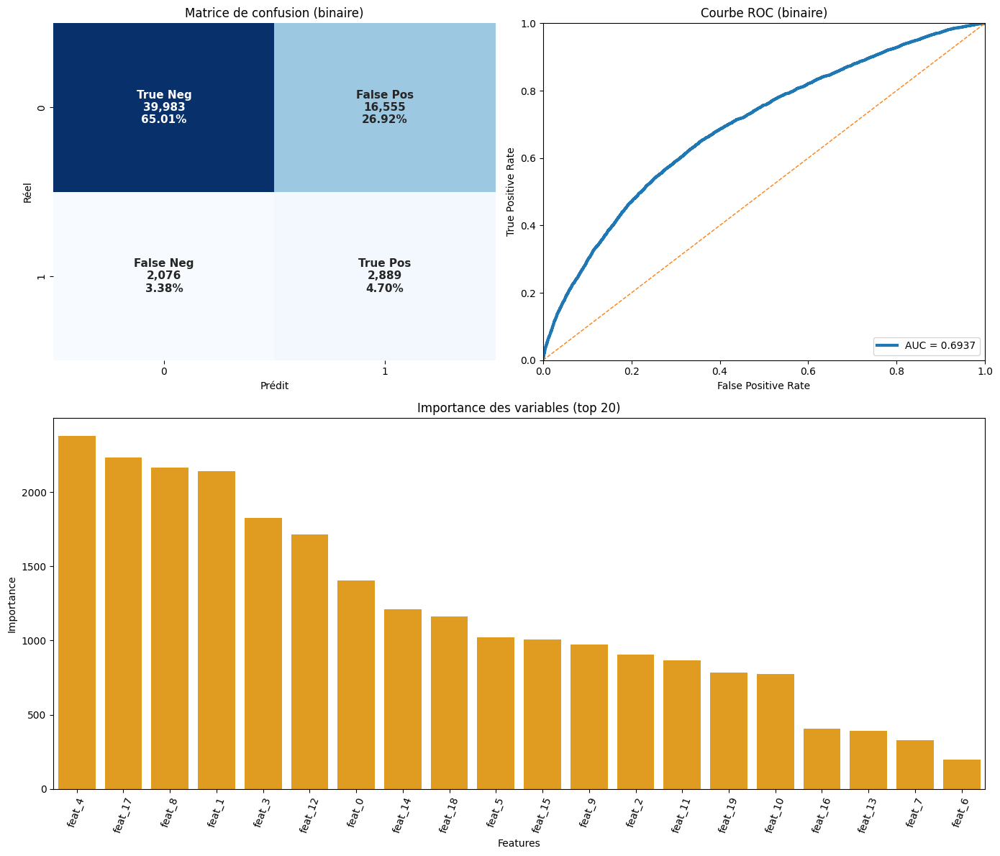

In [ ]:
# ================== TES CALCULS ==================
y_pred = final_pipe.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

y_proba = final_pipe.predict_proba(X_test)
if n_classes == 2:
    auc = roc_auc_score(y_test, y_proba[:, 1])
else:
    auc = roc_auc_score(y_test, y_proba, multi_class="ovr", average="weighted")
print(f"AUC test: {auc:.4f}")

# ================== PREP GÉNÉRALE ==================
classes = np.unique(y_test)
labels_sorted = np.sort(classes)
cm = confusion_matrix(y_test, y_pred, labels=labels_sorted)
total = cm.sum()

# ================== FIGURE ==================
plt.figure(figsize=(14,12))
gs = plt.GridSpec(2, 2, height_ratios=[1, 1.1])

# ---------- (1) MATRICE DE CONFUSION ----------
ax1 = plt.subplot(gs[0,0])

if n_classes == 2:
    # ordre [neg, pos]
    neg_label, pos_label = labels_sorted[0], labels_sorted[1]
    cm2 = confusion_matrix(y_test, y_pred, labels=[neg_label, pos_label])
    tn, fp, fn, tp = cm2.ravel()
    labels_text = np.array([
        [f"True Neg\n{tn:,}\n{tn/total:.2%}",
         f"False Pos\n{fp:,}\n{fp/total:.2%}"],
        [f"False Neg\n{fn:,}\n{fn/total:.2%}",
         f"True Pos\n{tp:,}\n{tp/total:.2%}"]
    ])
    sns.heatmap(cm2, annot=labels_text, fmt="", cmap="Blues", cbar=False,
                xticklabels=[neg_label, pos_label],
                yticklabels=[neg_label, pos_label],
                ax=ax1, annot_kws={"size":11, "weight":"bold"})
    ax1.set_title("Matrice de confusion (binaire)")
else:
    # multiclasse : comptes + %
    cm_pct = cm / cm.sum() * 100
    annot = np.array([[f"{cm[i,j]:,}\n{cm_pct[i,j]:.1f}%"
                       for j in range(cm.shape[1])] for i in range(cm.shape[0])])
    sns.heatmap(cm, annot=annot, fmt="", cmap="Blues", cbar=False,
                xticklabels=labels_sorted, yticklabels=labels_sorted,
                ax=ax1, annot_kws={"size":10})
    ax1.set_title("Matrice de confusion (multiclasse)")

ax1.set_xlabel("Prédit")
ax1.set_ylabel("Réel")

# ---------- (2) ROC ----------
ax2 = plt.subplot(gs[0,1])

if n_classes == 2:
    # binaire
    # repérer la colonne de la classe positive (labels_sorted[1])
    pos_idx = list(final_pipe.classes_).index(labels_sorted[1]) if hasattr(final_pipe, "classes_") else 1
    fpr, tpr, _ = roc_curve(y_test, y_proba[:, pos_idx], pos_label=labels_sorted[1])
    ax2.plot(fpr, tpr, lw=3, label=f"AUC = {auc:.4f}")
    ax2.plot([0,1], [0,1], "--", lw=1)
    ax2.set_title("Courbe ROC (binaire)")
    ax2.legend(loc="lower right")
else:
    # multiclasse OvR + macro-average
    Y_test_bin = label_binarize(y_test, classes=labels_sorted)
    # attention : y_proba doit être (n_samples, n_classes)
    fpr_dict, tpr_dict, auc_dict = {}, {}, {}
    for i, cls in enumerate(labels_sorted):
        fpr_dict[i], tpr_dict[i], _ = roc_curve(Y_test_bin[:, i], y_proba[:, i])
        auc_dict[i] = roc_auc_score(Y_test_bin[:, i], y_proba[:, i])
        ax2.plot(fpr_dict[i], tpr_dict[i], lw=1.75, label=f"{cls} (AUC={auc_dict[i]:.3f})")
    # macro-average (moyenne simple des TPR interpolés)
    all_fpr = np.unique(np.concatenate([fpr_dict[i] for i in range(len(labels_sorted))]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(len(labels_sorted)):
        mean_tpr += np.interp(all_fpr, fpr_dict[i], tpr_dict[i])
    mean_tpr /= len(labels_sorted)
    ax2.plot(all_fpr, mean_tpr, lw=3, label=f"Macro avg (AUC={auc:.3f})", linestyle="-")
    ax2.plot([0,1], [0,1], "--", lw=1)
    ax2.set_title("Courbes ROC OvR (multiclasse)")
    ax2.legend(loc="lower right", fontsize=9, ncol=1)

ax2.set_xlim(0,1); ax2.set_ylim(0,1)
ax2.set_xlabel("False Positive Rate")
ax2.set_ylabel("True Positive Rate")

# ---------- (3) IMPORTANCES DE VARIABLES ----------
ax3 = plt.subplot(gs[1,:])

# récupérer le dernier estimateur (pipeline ou modèle seul)
last_est = final_pipe.steps[-1][1] if hasattr(final_pipe, "steps") else final_pipe

if hasattr(last_est, "feature_importances_"):
    importances = last_est.feature_importances_
elif hasattr(last_est, "coef_"):
    coef = last_est.coef_
    coef = coef.ravel() if coef.ndim > 1 else coef
    importances = np.abs(coef)
else:
    importances = None

if importances is not None:
    # noms de variables si dispo
    if 'feature_names' in globals() and feature_names is not None and len(feature_names) == len(importances):
        names = np.array(feature_names)
    else:
        names = np.array([f"feat_{i}" for i in range(len(importances))])
    k = min(20, len(importances))
    idx = np.argsort(importances)[::-1][:k]
    sns.barplot(x=names[idx], y=importances[idx], color="orange", ax=ax3)
    ax3.set_title("Importance des variables (top 20)")
    ax3.set_ylabel("Importance")
    ax3.set_xlabel("Features")
    ax3.tick_params(axis="x", rotation=70)
else:
    ax3.axis("off")
    ax3.text(0.5, 0.5, "Importances non disponibles pour ce modèle.\n(ni feature_importances_ ni coef_)",
             ha="center", va="center", fontsize=12)

plt.tight_layout()
plt.show()

In [ ]:
# ------------------ ÉTAPE 2 : classes_ du modèle ------------------
# Récupère le dernier estimateur si tu as un Pipeline
last_est = final_pipe.steps[-1][1] if hasattr(final_pipe, "steps") else final_pipe
classes_ = np.array(last_est.classes_)
assert pos_label in classes_, f"pos_label {pos_label} absent de classes_={classes_}"

# Par commodité, on récupère aussi le label négatif
neg_label = classes_[classes_ != pos_label][0]
pos_idx = list(classes_).index(pos_label)

# ------------------ ÉTAPE 3 : scores/probas sur X_test ------------------
y_score = final_pipe.predict_proba(X_test)[:, pos_idx]   # proba de la classe positive


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Seuil	Précision_classe_0 (NPV)
0.05	0.0000
0.10	0.0000
0.15	0.9835
0.20	0.9809
0.25	0.9714
0.30	0.9660
0.35	0.9627
0.40	0.9589
0.45	0.9557
0.50	0.9506
0.55	0.9452
0.60	0.9383
0.65	0.9320
0.70	0.9265
0.75	0.9215
0.80	0.9193
0.85	0.9193
0.90	0.9193
0.95	0.9193
1.00	0.9193

AUC test (indépendant du seuil): 0.6937

Meilleur seuil (max précision classe 0): 0.15 avec précision_0 = 0.9835


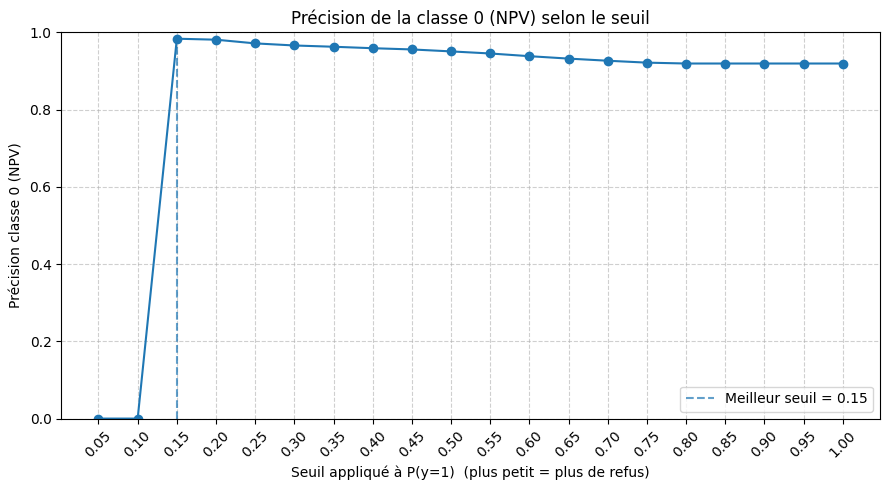

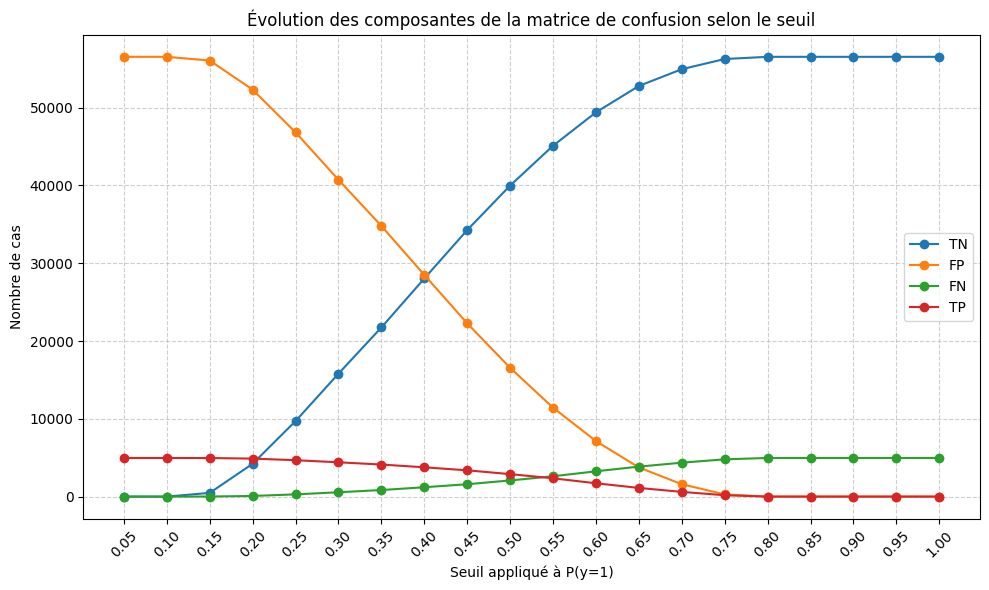

In [ ]:
# -------------------------------------------------------------------
# Hypothèses : vous avez déjà un modèle entraîné `model`,
# ainsi que X_test et y_test en mémoire.
# Classe 0 = crédit accordé (neg), Classe 1 = crédit non accordé (pos).
# -------------------------------------------------------------------
try:
    neg_label
except NameError:
    neg_label = 0
try:
    pos_label
except NameError:
    pos_label = 1

# ------------------ 1) Calcul de y_score = P(y = pos_label | x) ------------------
# Si y_score n'existe pas encore, on tente de le calculer à partir du modèle.
if 'y_score' not in globals():
    if 'model' not in globals():
        raise ValueError("Variable `model` introuvable : fournissez votre modèle entraîné.")
    if 'X_test' not in globals():
        raise ValueError("Variable `X_test` introuvable : fournissez vos features de test.")

    if hasattr(model, "predict_proba"):
        proba = model.predict_proba(X_test)  # shape (n_samples, n_classes)
        classes = getattr(model, "classes_", None)
        if classes is None:
            if proba.shape[1] != 2:
                raise ValueError("predict_proba ne retourne pas 2 colonnes et model.classes_ est indisponible.")
            pos_idx = 1  # on suppose la 2e colonne = classe positive
        else:
            matches = np.where(classes == pos_label)[0]
            if len(matches) == 0:
                raise ValueError(f"pos_label={pos_label} n'est pas dans model.classes_={classes}.")
            pos_idx = matches[0]
        y_score = proba[:, pos_idx].astype(float)

    elif hasattr(model, "decision_function"):
        # Scores non bornés ; mise à l'échelle 0-1 (non calibrée)
        scores = model.decision_function(X_test)
        scores = np.ravel(scores).astype(float)
        y_score = (scores - scores.min()) / (scores.max() - scores.min() + 1e-12)
        print("⚠️ Utilisation de decision_function : les scores ne sont pas des probabilités calibrées.")
    else:
        raise ValueError("Le modèle ne fournit ni `predict_proba` ni `decision_function`. Impossible de calculer `y_score`.")

# Sanity checks
y_score = np.ravel(y_score)
if y_score.shape[0] != len(y_test):
    raise ValueError(f"Dimension invalide : y_score a {y_score.shape[0]} éléments mais y_test en a {len(y_test)}.")
if (y_score < 0).any() or (y_score > 1).any():
    print("⚠️ Attention : y_score n'est pas borné dans [0,1]. (OK si issu de decision_function mise à l'échelle)")

# ------------------ 2) Grille de seuils ------------------
thresholds = np.round(np.arange(0.05, 1.0001, 0.05), 2)

precision_neg_list = []
details = []  # (seuil, tn, fp, fn, tp, precision_neg)

# Pour le graphe TN/FP/FN/TP
tn_list, fp_list, fn_list, tp_list = [], [], [], []

for seuil in thresholds:
    # Prédit "pos" (refus) si proba >= seuil, sinon "neg" (accord)
    y_pred = np.where(y_score >= seuil, pos_label, neg_label)

    # Matrice de confusion (ordre [neg, pos])
    cm = confusion_matrix(y_test, y_pred, labels=[neg_label, pos_label])
    tn, fp, fn, tp = cm.ravel()

    # Classification report -> précision de la classe "neg" (NPV = TN / (TN + FN))
    report = classification_report(
        y_test, y_pred,
        labels=[neg_label, pos_label],
        target_names=["neg", "pos"],
        output_dict=True,
        zero_division=0
    )
    precision_neg = report["neg"]["precision"]

    precision_neg_list.append(precision_neg)
    details.append((seuil, tn, fp, fn, tp, precision_neg))

    # Stocker pour le graphe des comptes
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)
    tp_list.append(tp)

# ------------------ 3) Affichage tableau récap ------------------
print("Seuil\tPrécision_classe_0 (NPV)")
for seuil, _, _, _, _, p0 in details:
    print(f"{seuil:.2f}\t{p0:.4f}")

# ------------------ 4) AUC (indépendant du seuil) ------------------
auc = roc_auc_score(y_test, y_score)
print(f"\nAUC test (indépendant du seuil): {auc:.4f}")

# ------------------ 5) Meilleur seuil sur la précision_0 ------------------
best_idx = int(np.argmax(precision_neg_list))
best_thr = float(thresholds[best_idx])
best_prec = float(precision_neg_list[best_idx])
print(f"\nMeilleur seuil (max précision classe 0): {best_thr:.2f} avec précision_0 = {best_prec:.4f}")

# ------------------ 6) Graphique précision (classe 0) vs seuil ------------------
plt.figure(figsize=(9, 5))
plt.plot(thresholds, precision_neg_list, marker="o")
plt.axvline(best_thr, linestyle="--", alpha=0.7, label=f"Meilleur seuil = {best_thr:.2f}")
plt.title("Précision de la classe 0 (NPV) selon le seuil")
plt.xlabel("Seuil appliqué à P(y=1)  (plus petit = plus de refus)")
plt.ylabel("Précision classe 0 (NPV)")
plt.xticks(thresholds, rotation=45)
plt.ylim(0, 1)
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()

# ------------------ 7) Graphique TN / FP / FN / TP vs seuil ------------------
plt.figure(figsize=(10, 6))
plt.plot(thresholds, tn_list, marker="o", label="TN")
plt.plot(thresholds, fp_list, marker="o", label="FP")
plt.plot(thresholds, fn_list, marker="o", label="FN")
plt.plot(thresholds, tp_list, marker="o", label="TP")
plt.title("Évolution des composantes de la matrice de confusion selon le seuil")
plt.xlabel("Seuil appliqué à P(y=1)")
plt.ylabel("Nombre de cas")
plt.xticks(thresholds, rotation=45)
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
# ------------------ ÉTAPE 1 : paramètres ------------------
t_star = 0.0909          # <-- ton seuil optimal (trouvé sur validation)
pos_label = 1            # <-- mets ici la valeur de ta classe "défaut/refuser"
                         #     (ex: 1, "bad", etc.)

# ------------------ ÉTAPE 2 : classes_ du modèle ------------------
# Récupère le dernier estimateur si tu as un Pipeline
last_est = final_pipe.steps[-1][1] if hasattr(final_pipe, "steps") else final_pipe
classes_ = np.array(last_est.classes_)
assert pos_label in classes_, f"pos_label {pos_label} absent de classes_={classes_}"

# Par commodité, on récupère aussi le label négatif
neg_label = classes_[classes_ != pos_label][0]
pos_idx = list(classes_).index(pos_label)

# ------------------ ÉTAPE 3 : scores/probas sur X_test ------------------
y_score = final_pipe.predict_proba(X_test)[:, pos_idx]   # proba de la classe positive



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


In [ ]:
for seuil in [0.0909   , 0.1, 0.4, 0.6]:
  # ------------------ ÉTAPE 4 : appliquer TON seuil ------------------
  y_pred = np.where(y_score >= seuil, pos_label, neg_label)

  # ------------------ ÉTAPE 5 : métriques dépendantes du seuil ------------------
  cm = confusion_matrix(y_test, y_pred, labels=[neg_label, pos_label])
  tn, fp, fn, tp = cm.ravel()
  print("Matrice de confusion (ordre: [neg, pos]):")
  print(cm)
  print(f"FPR = FP/(FP+TN) = {fp/(fp+tn+1e-12):.3f} | TPR/Recall = TP/(TP+FN) = {tp/(tp+fn+1e-12):.3f}\n")

  print("Classification report :")
  print(classification_report(
      y_test, y_pred,
      labels=[neg_label, pos_label],
      target_names=["neg", "pos"]
  ))

  # ------------------ ÉTAPE 6 : AUC (indépendant du seuil) ------------------
  auc = roc_auc_score(y_test, y_score)
  print(f"AUC test (indépendant du seuil): {auc:.4f}")

Matrice de confusion (ordre: [neg, pos]):
[[    0 56538]
 [    0  4965]]
FPR = FP/(FP+TN) = 1.000 | TPR/Recall = TP/(TP+FN) = 1.000

Classification report :
              precision    recall  f1-score   support

         neg       0.00      0.00      0.00     56538
         pos       0.08      1.00      0.15      4965

    accuracy                           0.08     61503
   macro avg       0.04      0.50      0.07     61503
weighted avg       0.01      0.08      0.01     61503

AUC test (indépendant du seuil): 0.6937
Matrice de confusion (ordre: [neg, pos]):
[[    0 56538]
 [    0  4965]]
FPR = FP/(FP+TN) = 1.000 | TPR/Recall = TP/(TP+FN) = 1.000

Classification report :
              precision    recall  f1-score   support

         neg       0.00      0.00      0.00     56538
         pos       0.08      1.00      0.15      4965

    accuracy                           0.08     61503
   macro avg       0.04      0.50      0.07     61503
weighted avg       0.01      0.08      0.01    

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/m

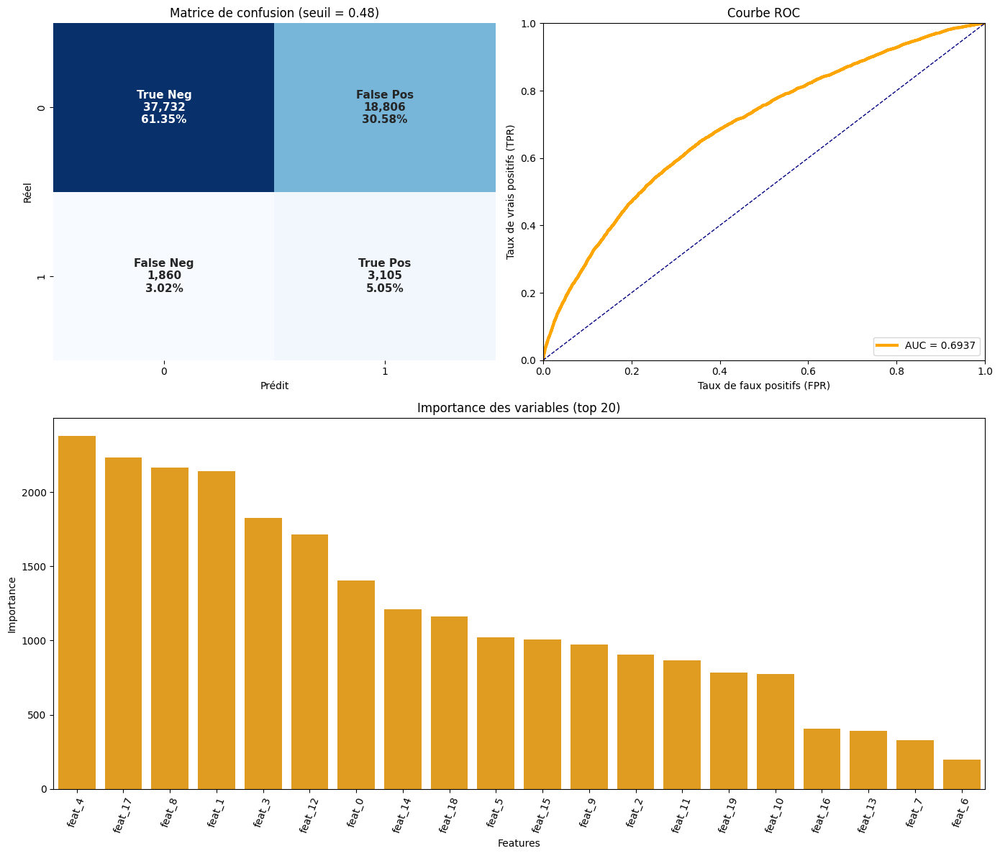

In [ ]:
seuil_display = 0.48
y_pred = np.where(y_score >= seuil_display, pos_label, neg_label)

# -------- 2) Matrice de confusion --------
cm = confusion_matrix(y_test, y_pred, labels=[neg_label, pos_label])
tn, fp, fn, tp = cm.ravel()
total = cm.sum()
cm_percent = cm / total * 100

# Texte explicatif pour chaque case
labels = np.array([
    [f"True Neg\n{tn:,}\n{tn/total:.2%}",
     f"False Pos\n{fp:,}\n{fp/total:.2%}"],
    [f"False Neg\n{fn:,}\n{fn/total:.2%}",
     f"True Pos\n{tp:,}\n{tp/total:.2%}"]
])

# -------- 3) ROC & AUC --------
fpr, tpr, _ = roc_curve(y_test, y_score, pos_label=pos_label)
auc = roc_auc_score(y_test, y_score)

# -------- 4) Importances --------
last_est = final_pipe.steps[-1][1] if hasattr(final_pipe, "steps") else final_pipe

if hasattr(last_est, "feature_importances_"):
    importances = last_est.feature_importances_
elif hasattr(last_est, "coef_"):
    coef = last_est.coef_.ravel() if np.ndim(last_est.coef_) > 1 else last_est.coef_
    importances = np.abs(coef)
else:
    importances = None

if importances is not None:
    if 'feature_names' in globals() and feature_names is not None and len(feature_names) == len(importances):
        names = np.array(feature_names)
    else:
        names = np.array([f"feat_{i}" for i in range(len(importances))])

    k = min(20, len(importances))
    idx = np.argsort(importances)[::-1][:k]
    top_names = names[idx]
    top_vals  = importances[idx]

# -------- 5) Figure seaborn --------
fig = plt.figure(figsize=(14,12))
gs = plt.GridSpec(2, 2, height_ratios=[1, 1.1])

# (a) Confusion matrix avec étiquettes explicites
ax1 = plt.subplot(gs[0,0])
sns.heatmap(cm, annot=labels, fmt="", cmap="Blues", cbar=False,
            xticklabels=[neg_label, pos_label],
            yticklabels=[neg_label, pos_label],
            ax=ax1, annot_kws={"size":11, "weight":"bold"})
ax1.set_title(f"Matrice de confusion (seuil = {seuil_display})")
ax1.set_xlabel("Prédit")
ax1.set_ylabel("Réel")

# (b) ROC
ax2 = plt.subplot(gs[0,1])
ax2.plot(fpr, tpr, color="orange", lw=3, label=f"AUC = {auc:.4f}")
ax2.plot([0,1], [0,1], "--", color="navy", lw=1)
ax2.set_xlim(0,1); ax2.set_ylim(0,1)
ax2.set_title("Courbe ROC")
ax2.set_xlabel("Taux de faux positifs (FPR)")
ax2.set_ylabel("Taux de vrais positifs (TPR)")
ax2.legend(loc="lower right")

# (c) Features importance
ax3 = plt.subplot(gs[1,:])
if importances is not None:
    sns.barplot(x=top_names, y=top_vals, color="orange", ax=ax3)
    ax3.set_title("Importance des variables (top 20)")
    ax3.set_ylabel("Importance")
    ax3.set_xlabel("Features")
    ax3.tick_params(axis="x", rotation=70)
else:
    ax3.text(0.5, 0.5, "Importances non disponibles pour ce modèle",
             ha="center", va="center", fontsize=12)
    ax3.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
X_test_df = X_test
if not hasattr(X_test, "columns"):
    import pandas as pd
    X_test_df = pd.DataFrame(X_test, columns=X_train.columns)

y_pred  = final_pipe.predict(X_test_df)
y_proba = final_pipe.predict_proba(X_test_df)

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


In [ ]:
missing = set(X_train.columns) - set(X_test_df.columns)
for c in missing:
    X_test_df[c] = 0
X_test_df = X_test_df[X_train.columns]

In [ ]:

print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred,
                            target_names=[str(c) for c in final_pipe.classes_]))

[[39983 16555]
 [ 2076  2889]]
              precision    recall  f1-score   support

           0       0.95      0.71      0.81     56538
           1       0.15      0.58      0.24      4965

    accuracy                           0.70     61503
   macro avg       0.55      0.64      0.52     61503
weighted avg       0.89      0.70      0.76     61503



## Changement de seuil afin d'améliorer le model

expérimentation sans aboutissement

In [ ]:
C_FP, C_FN = 1.0, 10.0
T_BAYES = C_FP / (C_FP + C_FN)   # 1/11 ≈ 0.0909
print("Seuil bayésien:", T_BAYES)

Seuil bayésien: 0.09090909090909091


In [ ]:
class ThresholdedClassifier(BaseEstimator, ClassifierMixin):
    """Compare p(classe=1) à un seuil fixe (bayésien par ex.)."""
    def __init__(self, base_estimator, threshold=1/11):
        self.base_estimator = base_estimator
        self.threshold = float(threshold)

    def fit(self, X, y):
        self.clf_ = clone(self.base_estimator)
        self.clf_.fit(X, y)
        # IMPORTANT: expose classes_ et pos_idx_ pour l'évaluation
        self.classes_ = getattr(self.clf_, "classes_", np.array([0, 1]))
        self.pos_idx_ = int(np.where(self.classes_ == 1)[0][0])
        return self

    def predict_proba(self, X):
        return self.clf_.predict_proba(X)

    def predict(self, X):
        p = self.predict_proba(X)[:, self.pos_idx_]
        return (p >= self.threshold).astype(int)

In [ ]:
base_model = CalibratedClassifierCV(clone(best_clf), method="sigmoid", cv=5)
thresholded_model = ThresholdedClassifier(base_estimator=base_model, threshold=1/11)

In [ ]:
thresholded_model = ThresholdedClassifier(base_estimator=base_model, threshold=T_BAYES)

final_pipe = ImbPipeline(steps=[
    ("preprocess", build_preprocess()),
    ("smote", build_sampler()),
    ("model", thresholded_model),
])

final_pipe.fit(X_train, y_train)
print("Pipeline entraînée. Seuil utilisé:", final_pipe.named_steps["model"].threshold)

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


Pipeline entraînée. Seuil utilisé: 0.09090909090909091


In [ ]:
needed_cols = num_cols + cat_cols
X_eval_df = pd.DataFrame(X_eval_array, columns=needed_cols)

# Toujours appeler la PIPELINE (pas le modèle nu) :
y_pred  = final_pipe.predict(X_eval_df)
y_proba = final_pipe.predict_proba(X_eval_df)[:, final_pipe.named_steps["model"].pos_idx_]

cm = confusion_matrix(y_eval, y_pred)
tn, fp, fn, tp = cm.ravel()
cost = C_FN*fn + C_FP*fp

print(cm)
print("Coût (10*FN + 1*FP):", cost)
print(classification_report(y_eval, y_pred, digits=4))

NameError: name 'X_eval_array' is not defined

## Export

In [ ]:
payload = {
    "pipeline": final_pipe,
    "feature_order": top20_features,
    "n_features_": len(top20_features),
    "all_columns_at_fit": list(X_train.columns),
}

with open("/content/drive/MyDrive/projet_7/pipeline_app.pkl", "wb") as f:
    pickle.dump(payload, f)

# Data Drift

In [ ]:
!pip install evidently

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 68.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.5/236.5 kB 21.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 564.3/564.3 kB 42.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.8/510.8 kB 41.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.6/213.6 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 117.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 452.2/452.2 kB 31.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.8/69.8 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 98.5 MB/s eta 0:00:00


In [ ]:
import evidently
print(evidently.__version__)


0.7.14


In [ ]:
from evidently import Report
from evidently.presets import DataDriftPreset

In [ ]:
data_train

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,...,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,SK_ID_CURR
0,0.0,0.001512,0.090287,0.090032,0.077441,0.256321,0.111161,0.964437,0.852140,0.705433,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,100002
1,0.0,0.002089,0.311736,0.132924,0.271605,0.045016,0.522886,0.933676,0.951929,0.959566,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,100003
2,0.0,0.000358,0.022472,0.020025,0.023569,0.134897,0.651466,0.987439,0.827335,0.648326,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100004
3,0.0,0.000935,0.066837,0.109477,0.063973,0.107023,0.649154,0.830337,0.601451,0.661387,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100006
4,0.0,0.000819,0.116854,0.078975,0.117845,0.392880,0.701409,0.830393,0.825268,0.519522,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.0,0.001127,0.052360,0.101176,0.046016,0.446855,0.103608,0.986824,0.657263,0.724607,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,456251
307507,0.0,0.000396,0.056067,0.040505,0.046016,0.344429,0.748929,0.907995,0.822147,0.431708,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,456252
307508,0.0,0.001089,0.157969,0.110618,0.135802,0.065247,0.421477,0.557782,0.726937,0.284424,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,456253
307509,0.0,0.001243,0.081175,0.072499,0.069585,0.069553,0.252086,0.732805,0.896158,0.870641,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,456254


In [ ]:
data_test

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,...,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,SK_ID_CURR
0,0.00,0.024654,0.238037,0.102453,0.184049,0.257380,0.333427,0.866682,0.782059,0.872086,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,100001
1,0.00,0.016440,0.080785,0.084558,0.061350,0.491855,0.399339,0.744130,0.615631,0.744329,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100005
2,0.00,0.040054,0.280965,0.378515,0.265849,0.260854,0.288794,0.744760,0.908313,0.448173,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100013
3,0.10,0.065721,0.695297,0.262078,0.695297,0.361760,0.628269,0.893197,0.915690,0.337114,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,100028
4,0.05,0.034920,0.263804,0.166995,0.263804,0.135340,0.680685,0.874585,0.831380,0.328607,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100038
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,0.00,0.021574,0.167035,0.085138,0.102249,0.024760,0.292602,0.704043,0.616643,0.464556,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,456221
48740,0.10,0.029787,0.262401,0.166111,0.204499,0.491855,0.784510,0.934257,0.872903,0.526938,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,456222
48741,0.05,0.040054,0.122699,0.173381,0.122699,0.361760,0.519292,0.826137,0.886983,0.763075,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,456223
48742,0.00,0.045187,0.184049,0.128073,0.184049,0.257380,0.628717,0.843661,0.938412,0.785129,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,456224


In [ ]:
reference = data_train   # données d'entraînement
current = data_test      # données de test

# Créer un rapport de data drift
report = Report(metrics=[DataDriftPreset()])
my_eval = report.run(reference_data=reference, current_data=current)
my_eval


/usr/local/lib/python3.12/dist-packages/numpy/lib/_function_base_impl.py:2922: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.12/dist-packages/numpy/lib/_function_base_impl.py:2923: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.12/dist-packages/numpy/lib/_function_base_impl.py:2922: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.12/dist-packages/numpy/lib/_function_base_impl.py:2923: RuntimeWarning:

invalid value encountered in divide



In [ ]:
my_eval.save_html("/content/drive/MyDrive/projet_7/data_drift_file.html")
